# Installations

In [ ]:
# !pip install soundfile
# !pip install torchaudio

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
!pip install comet_ml

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 713.5/713.5 kB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 979.7/979.7 kB 34.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 63.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.8/144.8 kB 12.1 MB/s eta 0:00:00
  Attempting uninstall: python-box
    Found existing installation: python-box 7.3.2
    Uninstalling python-box-7.3.2:
      Successfully uninstalled python-box-7.3.2


In [ ]:
from comet_ml import start
from comet_ml.integration.pytorch import log_model

experiment = start(
  api_key="OBlcxyUlLf02C82HAq9h6yEkz",
  project_name="v8-identity-force-normalized-spectrograms",
  workspace="ofirshechter"
)

COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.
COMET INFO: Experiment is live on comet.com https://www.comet.com/ofirshechter/v8-identity-force-normalized-spectrograms/6942ceab63514211b9271be891946df3



# Parameters


In [ ]:
working_sr = 16000

In [ ]:
import os
import soundfile as sf
import librosa
import numpy as np
import IPython.display as ipd
import torchaudio
import torch
import torch.nn as nn
from tqdm import tqdm

COMET INFO: Couldn't find a Git repository in '/content' nor in any parent directory. Set `COMET_GIT_DIRECTORY` if your Git Repository is elsewhere.


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
# original_songs_sr = 44100
# resampler = torchaudio.transforms.Resample(orig_freq=original_songs_sr, new_freq=working_sr)

# Load Data

In [ ]:
base_path = '/content/drive/MyDrive/Ofir/SoundProcessingFinalProject'
data_path = os.path.join(base_path, 'Data')
dataset_path = os.path.join(data_path, 'dataset_organized')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Load Audio Songs- no need, processed saved in drive

In [ ]:
# songs_path = os.path.join(data_path, 'songs')
# accompaniment_path = os.path.join(data_path, 'songs/accompaniment')
# vocal_path = os.path.join(data_path, 'songs/vocal')

In [ ]:
# songs_pairs = []
# for filename in os.listdir(accompaniment_path):
#     if filename.endswith(".wav"):
#         accompaniment_file = os.path.join(accompaniment_path, filename)
#         vocal_file = os.path.join(vocal_path, filename)

#         if os.path.exists(vocal_file):
#             try:
#                 # Load accompaniment and vocal files with torchaudio
#                 y_acc, sr_acc = torchaudio.load(accompaniment_file)  # [channels, samples]
#                 y_voc, sr_voc = torchaudio.load(vocal_file)

#                 # Check if sample rates are the same
#                 if sr_acc != sr_voc:
#                     print(f"Skipping {filename}: Different sample rates.")
#                     continue
#                 print(f"Sample Rate: {sr_acc}")

#                 # Ensure mono (convert stereo to mono if necessary)
#                 if y_acc.shape[0] > 1:
#                     y_acc = torch.mean(y_acc, dim=0, keepdim=True)
#                 if y_voc.shape[0] > 1:
#                     y_voc = torch.mean(y_voc, dim=0, keepdim=True)

#                 # Check if lengths are the same
#                 if y_acc.shape[1] != y_voc.shape[1]:
#                     print(f"Skipping {filename}: Different lengths.")
#                     continue

#                 songs_pairs.append((accompaniment_file, vocal_file))

#             except Exception as e:
#                 print(f"Error processing {filename}: {e}")

# print(f"Found {len(songs_pairs)} matching pairs.")

In [ ]:
# # Choose a pair by index (e.g., the first pair)
# index_to_play = 0  #@param {type:"integer"}

# if 0 <= index_to_play < len(songs_pairs):
#     accompaniment_file, vocal_file = songs_pairs[index_to_play]

#     print(f"Playing accompaniment: {accompaniment_file}")
#     ipd.display(ipd.Audio(accompaniment_file))

#     print(f"Playing vocal: {vocal_file}")
#     ipd.display(ipd.Audio(vocal_file))
# else:
#     print(f"Invalid index. Please choose an index between 0 and {len(songs_pairs) - 1}")


## Load Speech - no need, processed saved in drive

In [ ]:
# libri_speech_path = os.path.join(data_path, 'speech/LibriSpeech')

In [ ]:
# # prompt: Load LibriSpeech as pairs (audio-file, and transcript) from drive. structure: folders that contains folders that contains text file with the transcript and audio files

# libri_speech_pairs = []
# for root, _, files in os.walk(libri_speech_path):
#   #get the file that ends with .txt
#   for file in files:
#       if file.endswith(".txt"):
#         try:
#           with open(os.path.join(root, file), 'r') as f:
#             all_transcripts = f.read().strip()
#           # each row formated as '<file_name> <transcript>'
#           # example:
#           # 1272-141231-0003 HIS INSTANT OF PANIC WAS FOLLOWED BY A SMALL SHARP BLOW HIGH ON HIS CHEST while
#           # <file_name> = 1272-141231-0003 ; <transcript> = HIS INSTANT OF PANIC WAS FOLLOWED BY A SMALL SHARP BLOW HIGH ON HIS CHEST
#           # Parse all_transcripts and then Load file_name and save it as pair with its transcript (the one in the same line)
#           for line in all_transcripts.split('\n'):
#             audio_file_name, transcript = line.split(' ', 1)
#             audio_file_path = os.path.join(root, audio_file_name) + '.flac'
#             # Load the audio file
#             audio_file, sr = torchaudio.load(audio_file_path)
#             libri_speech_pairs.append((audio_file, transcript))
#         except Exception as e:
#           print(f"Error reading transcript for {line}: {e}")

# print(f"Found {len(libri_speech_pairs)} LibriSpeech pairs.")

In [ ]:
# # Example: Accessing the first pair
# if libri_speech_pairs:
#     audio_file, transcript = libri_speech_pairs[0]
#     print(f"Playing speech: {audio_file}")
#     ipd.display(ipd.Audio(audio_file, rate=sr))
#     print(f"Transcript: {transcript}")
# else:
#     print("No pairs found in libri_speech_pairs.")


# Prepare Data

In [ ]:
# spectogram parameters - currently by MelGAN
hop_length = 192
n_mels = hop_length
n_fft = hop_length * 6
sr = working_sr


## Mel Spectogram

In [ ]:
mel_transform  = torchaudio.transforms.MelSpectrogram(
    sample_rate=sr,
    n_fft=n_fft,
    win_length=n_fft,
    hop_length=hop_length,
    n_mels=n_mels,
)#.to('cuda')

def convert_waveform_to_mel_spectrogram(waveform):
    # Convert waveform to Mel spectrogram
    padded_waveform = torch.nn.functional.pad(waveform, (0, hop_length - waveform.size(1) % hop_length))
    mel_spectrogram = mel_transform(padded_waveform)  # Shape: [1, n_mels, time_steps]
    return mel_spectrogram

def slice_spectogram(mel_spectrogram, slice_duration):
  '''
  slice the spectogram into slices of the given duration, return list of slices
  '''
  samples_per_slice = int(sr * slice_duration / hop_length)  # Time steps per slice
  # Slice the spectrogram
  num_slices = mel_spectrogram.shape[2] // samples_per_slice
  slices = [mel_spectrogram[:, :, i * samples_per_slice:(i + 1) * samples_per_slice] for i in range(num_slices)]
  # convert slices to tensor
  slices = torch.stack(slices)

  return slices

### Data Helpers

In [ ]:
# prompt: take 2 pytorch mel spectograms batches, items in the batch are at the same length and combine items at the same index into one (like adding another audio channel- output: batch of mel spectogram at the same length that represent the original audio)

def combine_mel_spectrograms(batch1, batch2):
    """
    Combines two batches of mel spectrograms element-wise.

    Args:
        batch1: A batch of mel spectrograms (Tensor). Shape: (batch_size, n_mels, time_steps)
        batch2: A batch of mel spectrograms (Tensor). Shape: (batch_size, n_mels, time_steps)

    Returns:
        A combined batch of mel spectrograms (Tensor). Shape: (batch_size, 2, n_mels, time_steps)
    """

    # Check if input batches have the same dimensions
    if batch1.shape != batch2.shape:
        raise ValueError("Input batches must have the same dimensions.")

    # Combine the batches items
    combined_batch = batch1 + batch2
    return combined_batch


In [ ]:
# prompt: convert tensor mel-spectogram back to audio

import torch
import torchaudio

def convert_mel_to_audio(mel_spectrogram):
    """Converts a mel spectrogram back to an audio waveform.

    Args:
        mel_spectrogram: The mel spectrogram (torch.Tensor).

    Returns:
        The reconstructed audio waveform (torch.Tensor).
    """

    # Create an inverse mel spectrogram transform
    inverse_mel_transform = torchaudio.transforms.InverseMelScale(
        n_stft=n_fft // 2 + 1, n_mels=n_mels, sample_rate=sr
    )

    # Apply the inverse mel scale transform
    spectrogram = inverse_mel_transform(mel_spectrogram)

    # Create Griffin-Lim transform
    griffin_lim = torchaudio.transforms.GriffinLim(
        n_fft=n_fft, hop_length=hop_length
    )

    # Apply Griffin-Lim to reconstruct the waveform
    waveform = griffin_lim(spectrogram)
    return waveform


In [ ]:
def spectral_convergence(input, target):
    return 20 * ((input - target).norm().log10() - target.norm().log10())

def GRAD(spec, transform_fn, samples=None, init_x0=None, maxiter=1000, tol=1e-6, verbose=1, evaiter=10, lr=0.003):
    spec = torch.Tensor(spec)
    samples = (spec.shape[-1]*hop_length)-hop_length

    if init_x0 is None:
        init_x0 = spec.new_empty((1,samples)).normal_(std=1e-6)
    x = nn.Parameter(init_x0)
    T = spec

    criterion = nn.L1Loss()
    optimizer = torch.optim.Adam([x], lr=lr)

    bar_dict = {}
    metric_func = spectral_convergence
    bar_dict['spectral_convergence'] = 0
    metric = 'spectral_convergence'

    init_loss = None
    with tqdm(total=maxiter, disable=not verbose) as pbar:
        for i in range(maxiter):
            optimizer.zero_grad()
            V = transform_fn(x)
            loss = criterion(V, T)
            loss.backward()
            optimizer.step()
            lr = lr*0.9999
            for param_group in optimizer.param_groups:
              param_group['lr'] = lr

            if i % evaiter == evaiter - 1:
                with torch.no_grad():
                    V = transform_fn(x)
                    bar_dict[metric] = metric_func(V, spec).item()
                    l2_loss = criterion(V, spec).item()
                    pbar.set_postfix(**bar_dict, loss=l2_loss)
                    pbar.update(evaiter)

    return x.detach().view(-1).cpu()


### Convert Data- example- relay on the commented load data cells

In [ ]:
# # prompt: take songs pairs, convert to mel spectogram using the helpers functions above and convert back to audio and play it

# # Choose a pair by index
# index_to_play = 0  #@param {type:"integer"}

# if 0 <= index_to_play < len(songs_pairs):
#     accompaniment_file, vocal_file = songs_pairs[index_to_play]

#     # Load the accompaniment and vocal files
#     # y_acc, sr_acc = torchaudio.load(accompaniment_file)
#     y_voc, sr_voc = torchaudio.load(vocal_file)
#     y_voc = resampler(y_voc)
#     # Convert to mel spectrograms
#     # mel_acc = convert_waveform_to_mel_spectrogram(y_acc)
#     mel_voc = convert_waveform_to_mel_spectrogram(y_voc)
#     sliced = slice_spectogram(mel_voc, 10)[1]
#     # Combine the spectrograms (example: simple addition)
#     # combined_mel = combine_mel_spectrograms(mel_acc, mel_voc)

#     # Convert the combined spectrogram back to audio
#     reconstructed_audio = GRAD(sliced, mel_transform)

#     # Play the reconstructed audio
#     print("Playing reconstructed audio:")
#     ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
# else:
#     print(f"Invalid index. Please choose an index between 0 and {len(songs_pairs) - 1}")


# Model

In [ ]:
conv_dim = n_mels
d_conv_dim = 2 * conv_dim
k_common_size = 100
spec_norm = lambda x:  torch.nn.utils.spectral_norm(x) #Spectral normalization is a technique used to stabilize the training of GANs by controlling the Lipschitz constant of the layers.


## Generators

In [ ]:
# Convolutional layers extract features from the input.
# Deconvolutional layers upsample the feature maps to generate the output.
class generator_speech2sing(nn.Module):
    def __init__(self):
        super(generator_speech2sing,self).__init__()
        # Acc Prep
        self.conv1_acc = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 256, kernel_size = (192, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2_acc = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3_acc = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4_acc = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD_acc = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5_acc = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD_acc = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6_acc = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (192, 1), stride=(1, 1), padding=(0,0)))
        # Regular
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(2, 256, kernel_size = (192, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4 = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5 = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6 = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (192, 1), stride=(1, 1), padding=(0,0)))
    def forward(self,spec_speech, spec_acc):
        ############## ACC
        # print(spec_acc.shape)
        spec_pad_acc = torch.functional.F.pad(spec_acc,(1,1))
        conv1_out_acc = self.conv1_acc(spec_pad_acc)
        # print(conv1_out_acc.shape)
        conv2_out_acc = self.conv2_acc(conv1_out_acc)
        # print(conv2_out_acc.shape)
        conv3_out_acc = self.conv3_acc(conv2_out_acc)
        # print(conv3_out_acc.shape)
        deconv4_out_acc = self.deconv4_acc(conv3_out_acc , output_size = conv2_out_acc.size())
        deconv4_out_acc =  torch.cat([self.deconv4_BAD_acc(deconv4_out_acc),conv2_out_acc],1)
        # print(deconv4_out.shape)
        deconv5_out_acc = self.deconv5_acc(deconv4_out_acc , output_size = conv1_out_acc.size())
        deconv5_out_acc = torch.cat([self.deconv5_BAD_acc(deconv5_out_acc),conv1_out_acc],1)
        # print(deconv5_out.shape)
        deconv6_out_acc = torch.functional.F.tanh(self.deconv6_acc(deconv5_out_acc, output_size = spec_acc.size()))

        ##############
        # create spec- two channels of 'spec_speech, spec_acc'
        spec = torch.cat((spec_speech, deconv6_out_acc), 1)
        # print(spec.shape)
        spec_pad = torch.functional.F.pad(spec,(1,1))
        conv1_out = self.conv1(spec_pad)
        # print(conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print(conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print(conv3_out.shape)
        deconv4_out = self.deconv4(conv3_out , output_size = conv2_out.size())
        deconv4_out =  torch.cat([self.deconv4_BAD(deconv4_out),conv2_out],1)
        # print(deconv4_out.shape)
        deconv5_out = self.deconv5(deconv4_out , output_size = conv1_out.size())
        deconv5_out = torch.cat([self.deconv5_BAD(deconv5_out),conv1_out],1)
        # print(deconv5_out.shape)
        deconv6_out = torch.functional.F.tanh(self.deconv6(deconv5_out, output_size = spec.size()))
        return deconv6_out

In [ ]:
# Convolutional layers extract features from the input.
# Deconvolutional layers upsample the feature maps to generate the output.

class generator_sing2speech(nn.Module):
    def __init__(self):
        super(generator_sing2speech,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 256, kernel_size = (192, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4 = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5 = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6 = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (192, 1), stride=(1, 1), padding=(0,0)))
    def forward(self,spec):
        spec_pad = torch.functional.F.pad(spec,(1,1))
        conv1_out = self.conv1(spec_pad)
        # print(conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print(conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print(conv3_out.shape)
        deconv4_out = self.deconv4(conv3_out , output_size = conv2_out.size())
        deconv4_out =  torch.cat([self.deconv4_BAD(deconv4_out),conv2_out],1)
        # print(deconv4_out.shape)
        deconv5_out = self.deconv5(deconv4_out , output_size = conv1_out.size())
        deconv5_out = torch.cat([self.deconv5_BAD(deconv5_out),conv1_out],1)
        # print(deconv5_out.shape)
        deconv6_out = torch.functional.F.tanh(self.deconv6(deconv5_out, output_size = spec.size()))
        return deconv6_out

## Discrimenator

In [ ]:
class discriminator_vocal_accompaniment(nn.Module):
    def __init__(self):
        super(discriminator_vocal_accompaniment,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 512, kernel_size = (192, 3), stride=1,padding=(0,0))),

                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        # self.dense1 = nn.Sequential(nn.Linear(4352,640), nn.LeakyReLU(negative_slope=0.2,inplace=True))
        self.dense1 = torch.nn.utils.spectral_norm(nn.Linear(9216,1))
    def forward(self,spec):
        # print(spec.shape)
        conv1_out = self.conv1(spec)
        # print (conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print (conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print (conv3_out.shape)
        flatten = torch.flatten(conv3_out,start_dim=1)
        # print(flatten.shape)
        mean = torch.mean(flatten)
        # print(mean.shape)
        return mean
        # return self.dense2(d1)

In [ ]:
class discriminator_vocal(nn.Module):
    def __init__(self):
        super(discriminator_vocal,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 512, kernel_size = (192, 3), stride=1,padding=(0,0))),

                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        # self.dense1 = nn.Sequential(nn.Linear(4352,640), nn.LeakyReLU(negative_slope=0.2,inplace=True))
        self.dense1 = torch.nn.utils.spectral_norm(nn.Linear(9216,1))
    def forward(self,spec):
        # print(spec.shape)
        conv1_out = self.conv1(spec)
        # print (conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print (conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print (conv3_out.shape)
        flatten = torch.flatten(conv3_out,start_dim=1)
        # print(flatten.shape)
        mean = torch.mean(flatten)
        # print(mean.shape)
        return mean
        # return self.dense2(d1)

## Losses

In [ ]:
def mae(x,y):
  return torch.functional.F.l1_loss(x,y)

def mse(x,y):
  return torch.functional.F.l2_loss(x,y)

def d_loss_f(fake):
  return torch.mean(torch.relu(1 + fake))

def d_loss_r(real):
  return torch.mean(torch.relu(1 - real))

def g_loss_f(fake):
  return torch.mean(-fake)


## Network

In [ ]:
# Define the save path in Google Drive
save_path = os.path.join(base_path, 'saved_models', 'V8_identity_force_lower_acc')  # Adjust the path as needed
os.makedirs(save_path, exist_ok=True)  # Create the directory if it doesn't exist
# Save models after each epoch
gen_speech2sing_save_path = os.path.join(save_path, f'gen_speech2sing_const.pth')
gen_sing2speech_save_path = os.path.join(save_path, f'gen_sing2speech_epoch_const.pth')
discrim_whole_save_path = os.path.join(save_path, f'discrim_whole_epoch_const.pth')
discrim_vocal_save_path = os.path.join(save_path, f'discrim_vocal_epoch_const.pth')

def save_models(gen_speech2sing,gen_sing2speech,discrim_whole,discrim_vocal):
  torch.save(gen_speech2sing.state_dict(), gen_speech2sing_save_path)
  torch.save(gen_sing2speech.state_dict(), gen_sing2speech_save_path)
  torch.save(discrim_whole.state_dict(), discrim_whole_save_path)
  torch.save(discrim_vocal.state_dict(), discrim_vocal_save_path)


In [ ]:
a = generator_speech2sing()

In [ ]:
# a.conv1_acc[0].weight.grad

In [ ]:
#Get models and optimizers
def get_networks():
  global generator_speech2sing, generator_sing2speech, discriminator_vocal_accompaniment, discriminator_vocal
  gen_speech2sing = generator_speech2sing().to(device)
  gen_sing2speech = generator_sing2speech().to(device)
  discrim_whole = discriminator_vocal_accompaniment().to(device)
  discrim_vocal = discriminator_vocal().to(device)

  print('Built networks')
  #Load saved dicts
  if os.path.exists(gen_speech2sing_save_path):
    gen_speech2sing.load_state_dict(torch.load(gen_speech2sing_save_path, map_location=device))
    print('Loaded gen_speech2sing saved parameters')
  if os.path.exists(gen_sing2speech_save_path):
    gen_sing2speech.load_state_dict(torch.load(gen_sing2speech_save_path, map_location=device))
    print('Loaded gen_sing2speech saved parameters')
  if os.path.exists(discrim_whole_save_path):
    discrim_whole.load_state_dict(torch.load(discrim_whole_save_path, map_location=device))
    print('Loaded discrim_whole saved parameters')
  if os.path.exists(discrim_vocal_save_path):
    discrim_vocal.load_state_dict(torch.load(discrim_vocal_save_path, map_location=device))
    print('Loaded discrim_vocal saved parameters')

  opt_gen = torch.optim.Adam(list(gen_speech2sing.parameters())+list(gen_sing2speech.parameters()), lr=0.0001,betas=(0.5,0.999))
  opt_disc = torch.optim.Adam(list(discrim_whole.parameters())+list(discrim_vocal.parameters()), lr=0.00001,betas=(0.5,0.999)) # lr from 0.0001 to 0.00001


  return gen_speech2sing,gen_sing2speech,discrim_whole,discrim_vocal, [opt_gen,opt_disc]

#Set learning rate
def update_lr(lr,opt_gen,opt_disc):
  opt_gen.learning_rate = lr['gen']
  opt_disc.learning_rate = lr['disc']

# Train

In [ ]:
audio_duration = 2 #time of slice in seconds

In [ ]:
def get_song_pairs(root_dir):
    song_pairs = []
    for folder_name in os.listdir(root_dir):
        folder_path = os.path.join(root_dir, folder_name)
        if os.path.isdir(folder_path):
            voc_files = []
            acc_files = []
            for file_name in os.listdir(folder_path):
                if file_name.startswith('voc_') and file_name.endswith('.wav'):
                    voc_files.append(os.path.join(folder_path, file_name))
                elif file_name.startswith('acc_') and file_name.endswith('.wav'):
                    acc_files.append(os.path.join(folder_path, file_name))

            # Match voc and acc files based on index (assuming consistent naming)
            for voc_file in voc_files:
                base_name = os.path.basename(voc_file)
                index_str = base_name[4:-4]  # Extract index from "voc_1.wav"
                matching_acc_file = os.path.join(folder_path, f"acc_{index_str}.wav")
                if matching_acc_file in acc_files:
                  song_pairs.append((voc_file, matching_acc_file))

    return song_pairs

# Example usage
songs_root = os.path.join(dataset_path, f'songs_{audio_duration}s')
songs_pairs = get_song_pairs(songs_root)

# Print the pairs found len
len(songs_pairs)


45524

In [ ]:
def get_librispeech_paths(libri_speech_path):
  speech_paths = []
  for root, _, files in os.walk(libri_speech_path):
    #get the file that ends with .txt
    for file in files:
      file_path = os.path.join(root, file)
      speech_paths.append(file_path)
  return speech_paths


libri_speech_path = os.path.join(dataset_path, f'Librispeech_{audio_duration}s')
speech_paths = get_librispeech_paths(libri_speech_path)
len(speech_paths)

2703

In [ ]:
# # prompt: create function that takes files from drive and create randomized batches from them

# import random

# def create_randomized_batches(file_paths, batch_size):
#   """
#   Creates randomized batches from a list of file paths.

#   Args:
#     file_paths: A list of file paths.
#     batch_size: The desired batch size.

#   Returns:
#     A list of randomized batches, where each batch is a list of file paths.
#   """

#   random.shuffle(file_paths)  # Shuffle the file paths randomly
#   num_batches = (len(file_paths) + batch_size - 1) // batch_size  # Calculate the number of batches
#   batches = []
#   for i in range(num_batches):
#     start_index = i * batch_size
#     end_index = min((i + 1) * batch_size, len(file_paths))
#     batches.append(file_paths[start_index:end_index])
#   return batches

# speech_batches = create_randomized_batches(speech_paths, 2)
# songs_batches = create_randomized_batches(songs_pairs, 2)

# print(len(speech_batches))
# print(len(songs_batches))

In [ ]:
import random

class audio_dataset(torch.utils.data.Dataset):
  def __init__(self, songs_pairs, speech_paths):
    self.songs_pairs = songs_pairs
    self.speech_paths = speech_paths
  def __len__(self):
    return len(self.songs_pairs)

  def __getitem__(self, index):

    # get random file from songs_pairs and speech_paths
    song_pair = random.choice(self.songs_pairs)
    speech_path = random.choice(self.speech_paths)

    voc,sr = torchaudio.load(song_pair[0])
    acc, sr = torchaudio.load(song_pair[1])

    speech, sr = torchaudio.load(speech_path)

    # Convert to mel spectrogram
    mel_acc = convert_waveform_to_mel_spectrogram(acc)
    mel_voc = convert_waveform_to_mel_spectrogram(voc)
    mel_speech = convert_waveform_to_mel_spectrogram(speech)


    return mel_acc, mel_voc, mel_speech

In [ ]:
ds = audio_dataset(songs_pairs, speech_paths)

In [ ]:
dl = torch.utils.data.DataLoader(ds, batch_size=10, shuffle=True, num_workers = 2)

In [ ]:
device

'cpu'

In [ ]:
# Example usage (assuming you have defined epochs, batch_size, and other parameters)
epochs = 20
gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers = get_networks()
# train(epochs, songs_batches, speech_batches, gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers)


Built networks


<ipython-input-32-eeb011fa2ce1>:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen_speech2sing.load_state_dict(torch.load(gen_speech2sing_save_path, map_location=device))

Loaded gen_speech2sing saved parameters


<ipython-input-32-eeb011fa2ce1>:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen_sing2speech.load_state_dict(torch.load(gen_sing2speech_save_path, map_location=device))

Loaded gen_sing2speech saved parameters


<ipython-input-32-eeb011fa2ce1>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  discrim_whole.load_state_dict(torch.load(discrim_whole_save_path, map_location=device))


Loaded discrim_whole saved parameters


<ipython-input-32-eeb011fa2ce1>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  discrim_vocal.load_state_dict(torch.load(discrim_vocal_save_path, map_location=device))


Loaded discrim_vocal saved parameters


# log to comet

In [ ]:
from comet_ml.integration.pytorch import log_model

# Log the models to Comet
log_model(experiment, gen_speech2sing, 'gen_speech2sing')
log_model(experiment, gen_sing2speech, 'gen_sing2speech')
log_model(experiment, discrim_whole, 'discrim_whole')
log_model(experiment, discrim_vocal, 'discrim_vocal')

# log spectrogram parameters to Comet
experiment.log_parameters({
    "spectrogram_parameters": {
        "n_fft": n_fft,
        "hop_length": hop_length,
        "n_mels": n_mels,
        "sample_rate": sr,
    }
})

In [ ]:
# gen_speech2sing.to('cuda')
# gen_sing2speech.to('cuda')
# discrim_whole.to('cuda')
# discrim_vocal.to('cuda')

In [ ]:
import matplotlib.pyplot as plt
def display_spectrogram(spectrogram, title, ax, vmin, vmax, ylabel='freq_bin', aspect='auto', xmax=None):
  ax.set_title(title)
  ax.set_ylabel(ylabel)
  ax.set_xlabel('time-bins')
  im = ax.imshow(librosa.power_to_db(spectrogram), origin='lower', aspect=aspect, vmin=vmin, vmax=vmax)
  if xmax:
    ax.set_xlim((0, xmax))
  return im  # Return the image for colorbar


# Run Training Loop

Running batch 0
~ Running singing ~
tensor(3.7203e-06)
d_loss: 3.938371181488037; built of 'd_loss_whole:1.9684185981750488' & 'd_loss_vocal':1.9699527025222778
g_loss: 0.5559450387954712; built of 'g_loss_whole:-0.07779685407876968' & 'g_loss_vocal:-0.06360157579183578' & 'mae_loss_speech:0.2886116271838546' & 'mae_loss_identity:0.33871473278850317
generated singing:


100%|██████████| 1000/1000 [00:08<00:00, 116.64it/s, loss=0.00217, spectral_convergence=-4.54]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 102.90it/s, loss=0.000834, spectral_convergence=-16.2]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 101.66it/s, loss=0.00179, spectral_convergence=-9.11]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 117.54it/s, loss=0.000862, spectral_convergence=-15.3]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 99.94it/s, loss=0.00225, spectral_convergence=-10.8]


display spectrograms


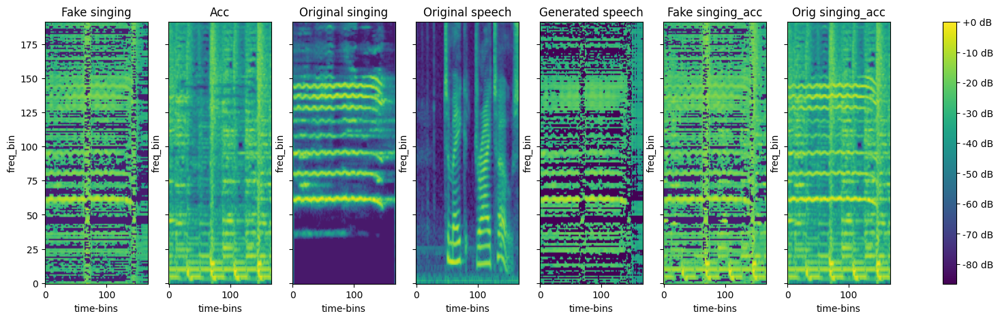

COMET WARNING: You are trying to log string value as a metric. This is not recommended.
COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(0.)
d_loss: 3.8920412063598633; built of 'd_loss_whole:1.9454748630523682' & 'd_loss_vocal':1.9465663433074951
g_loss: 0.03271216154098511; built of 'g_loss_whole:-0.055505406111478806' & 'g_loss_vocal:-0.040600188076496124' & 'mae_loss_speech:0.07886289386078715' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:10<00:00, 91.73it/s, loss=0.00149, spectral_convergence=-1.39]


song original singing:


100%|██████████| 1000/1000 [00:10<00:00, 94.00it/s, loss=0.000845, spectral_convergence=-15.7]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 99.81it/s, loss=0.000698, spectral_convergence=-10.4]


original speech


100%|██████████| 1000/1000 [00:11<00:00, 88.69it/s, loss=0.000261, spectral_convergence=-13.2]


fake combine


100%|██████████| 1000/1000 [00:10<00:00, 98.75it/s, loss=0.00177, spectral_convergence=-10]


display spectrograms


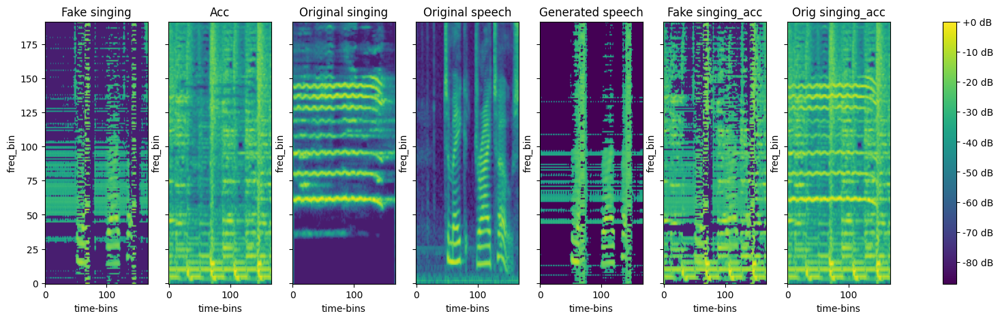

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1
~ Running singing ~
tensor(2.2321e-05)
d_loss: 3.9576942920684814; built of 'd_loss_whole:1.97860848903656' & 'd_loss_vocal':1.9790858030319214
g_loss: 0.3524676561355591; built of 'g_loss_whole:-0.077753446996212' & 'g_loss_vocal:-0.058954451233148575' & 'mae_loss_speech:0.18387003801763058' & 'mae_loss_identity:0.23532742634415627
~ Running speech ~
tensor(2.2322e-05)
d_loss: 3.931162118911743; built of 'd_loss_whole:1.96568763256073' & 'd_loss_vocal':1.9654744863510132
g_loss: 0.03222417086362839; built of 'g_loss_whole:-0.06576240062713623' & 'g_loss_vocal:-0.04574165493249893' & 'mae_loss_speech:0.0845420639961958' & 'mae_loss_identity:0.0
Running batch 2
~ Running singing ~
tensor(5.5804e-05)
d_loss: 3.977030038833618; built of 'd_loss_whole:1.9885070323944092' & 'd_loss_vocal':1.988523006439209
g_loss: 0.20016765594482422; built of 'g_loss_whole:-0.06928501278162003' & 'g_loss_vocal:-0.04747150465846062' & 'mae_loss_speech:0.11302370112389326' & 'mae_loss_identit

100%|██████████| 1000/1000 [00:12<00:00, 81.26it/s, loss=0.000553, spectral_convergence=-6.53]


song original singing:


100%|██████████| 1000/1000 [00:12<00:00, 82.07it/s, loss=0.000331, spectral_convergence=-10.6]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 69.76it/s, loss=0.000458, spectral_convergence=-7.65]


original speech


100%|██████████| 1000/1000 [00:13<00:00, 73.49it/s, loss=0.000341, spectral_convergence=-10.1]


fake combine


100%|██████████| 1000/1000 [00:12<00:00, 78.83it/s, loss=0.000705, spectral_convergence=-8.93]


display spectrograms


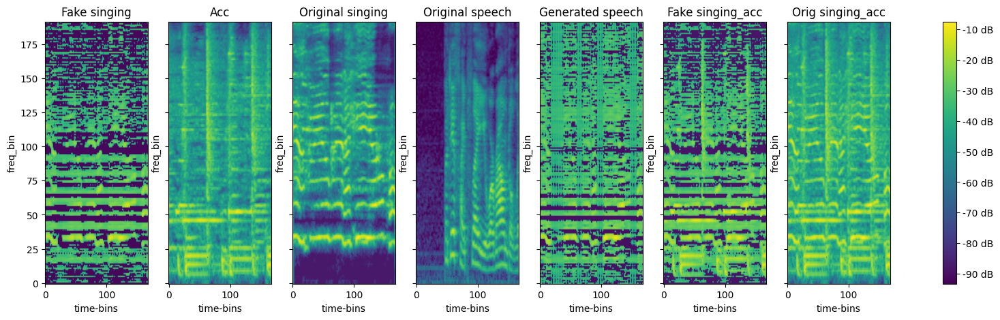

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(8.1846e-05)
d_loss: 3.963045835494995; built of 'd_loss_whole:1.9817419052124023' & 'd_loss_vocal':1.9813039302825928
g_loss: 0.02751905843615532; built of 'g_loss_whole:-0.05910500884056091' & 'g_loss_vocal:-0.04272036626935005' & 'mae_loss_speech:0.07614992209710181' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:13<00:00, 76.30it/s, loss=0.000342, spectral_convergence=-2.71]


song original singing:


100%|██████████| 1000/1000 [00:13<00:00, 76.90it/s, loss=0.000362, spectral_convergence=-9.76]


generated speech:


100%|██████████| 1000/1000 [00:13<00:00, 76.88it/s, loss=0.000181, spectral_convergence=-3.77]


original speech


100%|██████████| 1000/1000 [00:13<00:00, 75.54it/s, loss=7.3e-5, spectral_convergence=-7.17]


fake combine


100%|██████████| 1000/1000 [00:13<00:00, 75.48it/s, loss=0.000505, spectral_convergence=-9.95]


display spectrograms


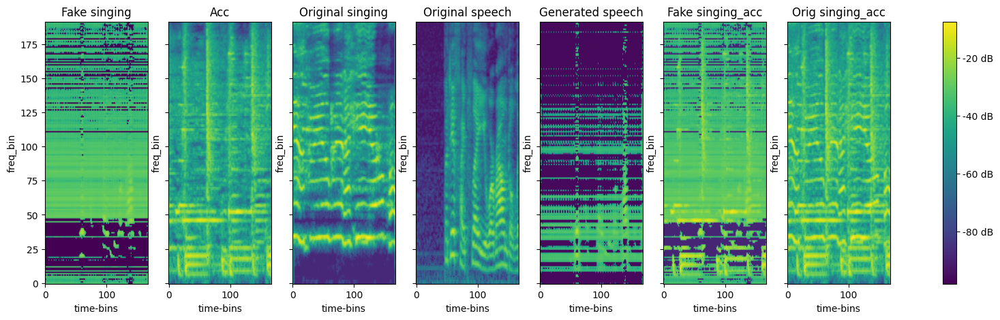

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 101
~ Running singing ~
tensor(3.7203e-05)
d_loss: 3.97220778465271; built of 'd_loss_whole:1.9860429763793945' & 'd_loss_vocal':1.9861648082733154
g_loss: 0.260631799697876; built of 'g_loss_whole:-0.0658535286784172' & 'g_loss_vocal:-0.048697397112846375' & 'mae_loss_speech:0.148741586599499' & 'mae_loss_identity:0.16717297257855535
~ Running speech ~
tensor(0.)
d_loss: 3.9652962684631348; built of 'd_loss_whole:1.9828282594680786' & 'd_loss_vocal':1.9824681282043457
g_loss: 0.03298235684633255; built of 'g_loss_whole:-0.0623924657702446' & 'g_loss_vocal:-0.0448727123439312' & 'mae_loss_speech:0.08409431902691722' & 'mae_loss_identity:0.0
Running batch 102
~ Running singing ~
tensor(3.7203e-06)
d_loss: 3.971447467803955; built of 'd_loss_whole:1.9855718612670898' & 'd_loss_vocal':1.9858756065368652
g_loss: 0.267752468585968; built of 'g_loss_whole:-0.06977469474077225' & 'g_loss_vocal:-0.05115729570388794' & 'mae_loss_speech:0.14232394751161337' & 'mae_loss_identity:0.1

100%|██████████| 1000/1000 [00:15<00:00, 64.57it/s, loss=0.000276, spectral_convergence=-4.25]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.64it/s, loss=0.00011, spectral_convergence=-4]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 66.40it/s, loss=0.000298, spectral_convergence=-1.09]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.14it/s, loss=9.58e-5, spectral_convergence=-5.32]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 68.74it/s, loss=0.000358, spectral_convergence=-7.16]


display spectrograms


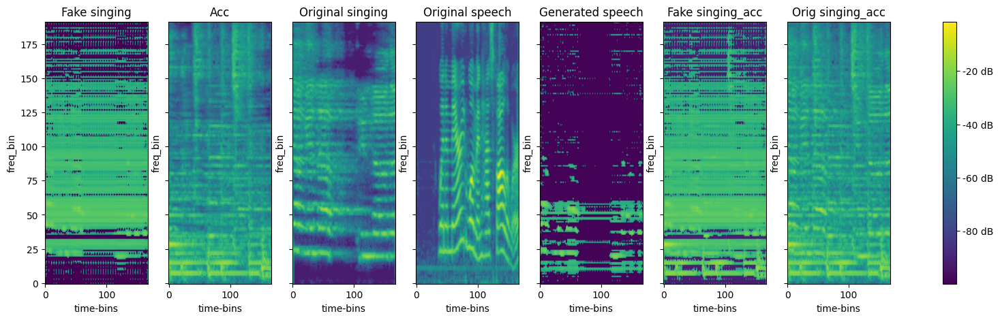

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.1161e-05)
d_loss: 3.9951562881469727; built of 'd_loss_whole:1.9978560209274292' & 'd_loss_vocal':1.997300148010254
g_loss: 0.043905410915613174; built of 'g_loss_whole:-0.06694450229406357' & 'g_loss_vocal:-0.044421013444662094' & 'mae_loss_speech:0.0950208748690784' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.13it/s, loss=0.000443, spectral_convergence=-9.81]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.10it/s, loss=0.0001, spectral_convergence=-5.02]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 67.23it/s, loss=0.000271, spectral_convergence=-12.2]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.86it/s, loss=0.000182, spectral_convergence=-17.6]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 68.06it/s, loss=0.000502, spectral_convergence=-9.16]


display spectrograms


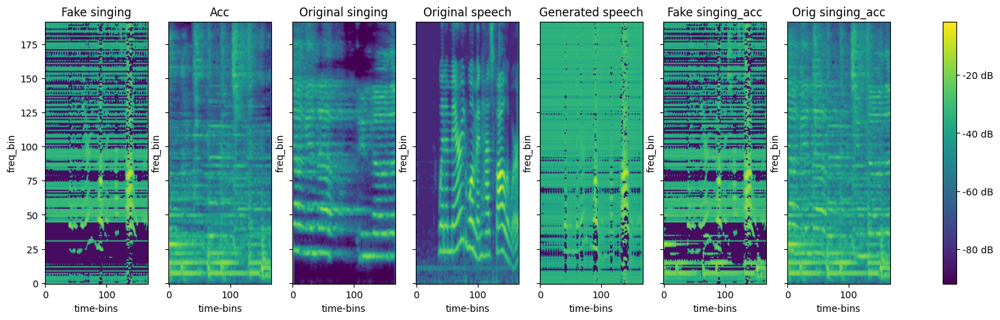

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 201
~ Running singing ~
tensor(3.7202e-05)
d_loss: 3.975912094116211; built of 'd_loss_whole:1.9880694150924683' & 'd_loss_vocal':1.9878425598144531
g_loss: 0.1611148864030838; built of 'g_loss_whole:-0.07335550338029861' & 'g_loss_vocal:-0.04572298750281334' & 'mae_loss_speech:0.0889791117515415' & 'mae_loss_identity:0.1251943176612258
~ Running speech ~
tensor(3.7203e-06)
d_loss: 3.9742417335510254; built of 'd_loss_whole:1.9879460334777832' & 'd_loss_vocal':1.9862958192825317
g_loss: 0.04250381514430046; built of 'g_loss_whole:-0.07347578555345535' & 'g_loss_vocal:-0.04427606612443924' & 'mae_loss_speech:0.09412746294401586' & 'mae_loss_identity:0.0
Running batch 202
~ Running singing ~
tensor(1.4881e-05)
d_loss: 3.9712677001953125; built of 'd_loss_whole:1.9858869314193726' & 'd_loss_vocal':1.9853808879852295
g_loss: 0.22842425107955933; built of 'g_loss_whole:-0.07376927137374878' & 'g_loss_vocal:-0.04523841664195061' & 'mae_loss_speech:0.12175572337582707' & 'mae_lo

100%|██████████| 1000/1000 [00:14<00:00, 68.87it/s, loss=0.000743, spectral_convergence=-11.4]


song original singing:


100%|██████████| 1000/1000 [00:14<00:00, 69.75it/s, loss=0.000359, spectral_convergence=-13.4]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 68.31it/s, loss=0.000866, spectral_convergence=-10.6]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.19it/s, loss=0.000366, spectral_convergence=-14.3]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 67.09it/s, loss=0.00087, spectral_convergence=-13.1]


display spectrograms


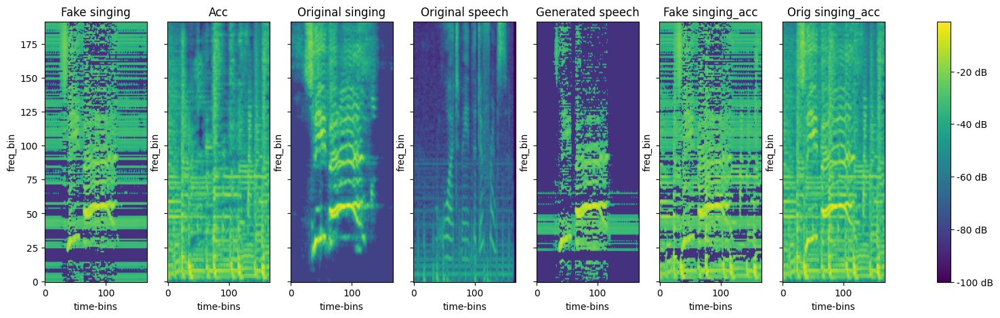

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(0.)
d_loss: 3.952404737472534; built of 'd_loss_whole:1.9779691696166992' & 'd_loss_vocal':1.974435567855835
g_loss: 0.023884601891040802; built of 'g_loss_whole:-0.0636366456747055' & 'g_loss_vocal:-0.04284646734595299' & 'mae_loss_speech:0.07309473003260791' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:14<00:00, 68.80it/s, loss=0.000366, spectral_convergence=-0.749]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.19it/s, loss=0.000373, spectral_convergence=-13.5]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.72it/s, loss=0.00021, spectral_convergence=4.44]


original speech


100%|██████████| 1000/1000 [00:14<00:00, 66.79it/s, loss=2.75e-5, spectral_convergence=4.95]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 67.09it/s, loss=0.000578, spectral_convergence=-14.2]


display spectrograms


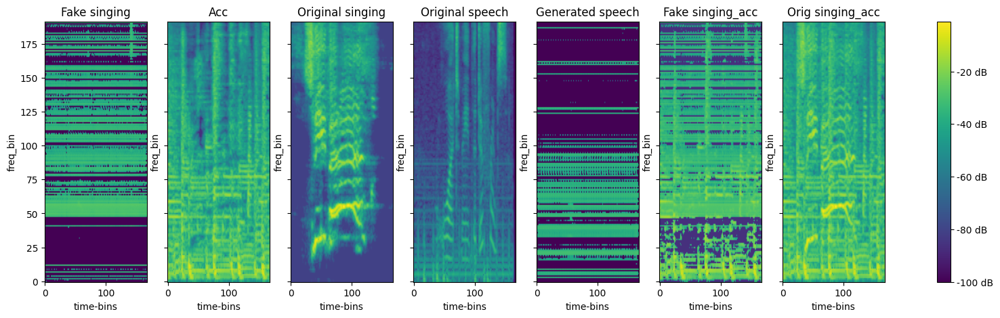

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 301
~ Running singing ~
tensor(3.7203e-06)
d_loss: 3.987273693084717; built of 'd_loss_whole:1.9939427375793457' & 'd_loss_vocal':1.993330955505371
g_loss: 0.12510953843593597; built of 'g_loss_whole:-0.06814159452915192' & 'g_loss_vocal:-0.04061858728528023' & 'mae_loss_speech:0.08027188596315682' & 'mae_loss_identity:0.09227039408870041
~ Running speech ~
tensor(0.)
d_loss: 3.986225128173828; built of 'd_loss_whole:1.9940084218978882' & 'd_loss_vocal':1.99221670627594
g_loss: 0.001927599310874939; built of 'g_loss_whole:-0.0683479979634285' & 'g_loss_vocal:-0.039315614849328995' & 'mae_loss_speech:0.04807801451534033' & 'mae_loss_identity:0.0
Running batch 302
~ Running singing ~
tensor(2.9762e-05)
d_loss: 3.952915668487549; built of 'd_loss_whole:1.9770188331604004' & 'd_loss_vocal':1.9758967161178589
g_loss: 0.3488397002220154; built of 'g_loss_whole:-0.07751476764678955' & 'g_loss_vocal:-0.05296943336725235' & 'mae_loss_speech:0.1886025653220713' & 'mae_loss_identity

100%|██████████| 1000/1000 [00:14<00:00, 67.71it/s, loss=0.000417, spectral_convergence=-3.3]


song original singing:


100%|██████████| 1000/1000 [00:14<00:00, 67.34it/s, loss=6.86e-5, spectral_convergence=-4.27]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 66.29it/s, loss=0.000242, spectral_convergence=-2.23]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.83it/s, loss=6.47e-5, spectral_convergence=-5.76]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 68.65it/s, loss=0.000478, spectral_convergence=-6.06]


display spectrograms


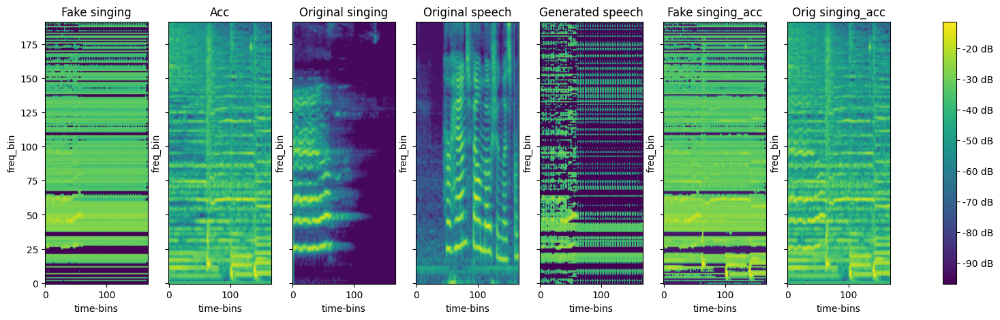

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.1161e-05)
d_loss: 3.978536605834961; built of 'd_loss_whole:1.989687204360962' & 'd_loss_vocal':1.988849401473999
g_loss: -0.013873500749468803; built of 'g_loss_whole:-0.05461513251066208' & 'g_loss_vocal:-0.037951018661260605' & 'mae_loss_speech:0.029539031675085425' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:14<00:00, 67.45it/s, loss=0.000336, spectral_convergence=-4.3]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.28it/s, loss=7.11e-5, spectral_convergence=-5.05]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 70.37it/s, loss=0.000173, spectral_convergence=-4.8]


original speech


100%|██████████| 1000/1000 [00:14<00:00, 67.19it/s, loss=8.61e-5, spectral_convergence=-6.13]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.96it/s, loss=0.000409, spectral_convergence=-7.23]


display spectrograms


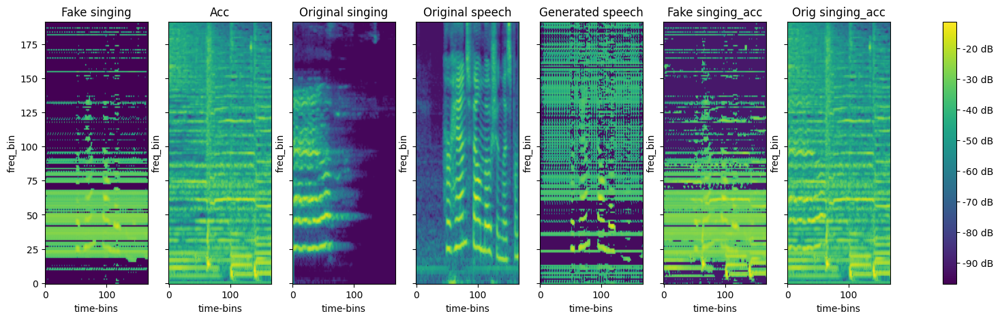

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 401
~ Running singing ~
tensor(8.9287e-05)
d_loss: 3.9610953330993652; built of 'd_loss_whole:1.9802567958831787' & 'd_loss_vocal':1.9808385372161865
g_loss: 0.2712894678115845; built of 'g_loss_whole:-0.06155162677168846' & 'g_loss_vocal:-0.04835151135921478' & 'mae_loss_speech:0.1431638840585947' & 'mae_loss_identity:0.18263226374983788
~ Running speech ~
tensor(0.0001)
d_loss: 3.950423002243042; built of 'd_loss_whole:1.9750144481658936' & 'd_loss_vocal':1.9754085540771484
g_loss: 0.015492558479309082; built of 'g_loss_whole:-0.05673785135149956' & 'g_loss_vocal:-0.043240029364824295' & 'mae_loss_speech:0.06440637516789138' & 'mae_loss_identity:0.0
Running batch 402
~ Running singing ~
tensor(5.5804e-05)
d_loss: 3.986678123474121; built of 'd_loss_whole:1.9932575225830078' & 'd_loss_vocal':1.9934206008911133
g_loss: 0.1859281212091446; built of 'g_loss_whole:-0.06492246687412262' & 'g_loss_vocal:-0.05227901041507721' & 'mae_loss_speech:0.10117592755705118' & 'mae_loss_

100%|██████████| 1000/1000 [00:14<00:00, 66.87it/s, loss=0.000318, spectral_convergence=-3.68]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.51it/s, loss=4.83e-5, spectral_convergence=-2.01]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.90it/s, loss=0.000217, spectral_convergence=-1.18]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.74it/s, loss=4.64e-5, spectral_convergence=0.163]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 67.08it/s, loss=0.000379, spectral_convergence=-4.66]


display spectrograms


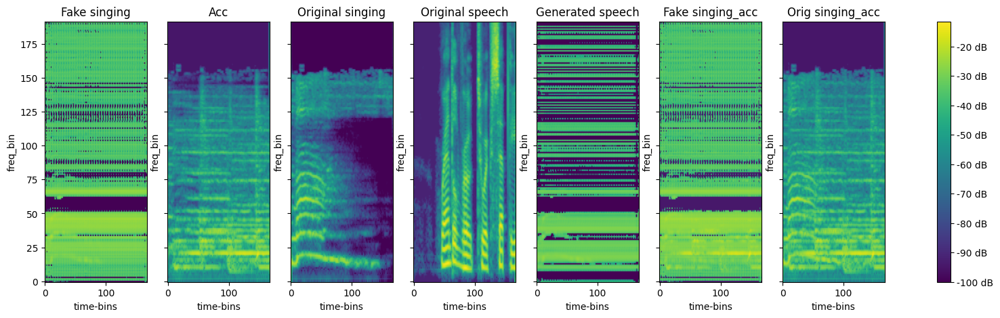

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(7.4405e-06)
d_loss: 3.9766488075256348; built of 'd_loss_whole:1.9885149002075195' & 'd_loss_vocal':1.9881339073181152
g_loss: -0.0031436681747436523; built of 'g_loss_whole:-0.06657156348228455' & 'g_loss_vocal:-0.046281278133392334' & 'mae_loss_speech:0.04979476798325777' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 62.79it/s, loss=0.00042, spectral_convergence=-6.41]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 63.16it/s, loss=4.38e-5, spectral_convergence=-2.17]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 64.52it/s, loss=0.00019, spectral_convergence=-4.16]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.99it/s, loss=0.00015, spectral_convergence=-8.97]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 68.18it/s, loss=0.000463, spectral_convergence=-6.82]


display spectrograms


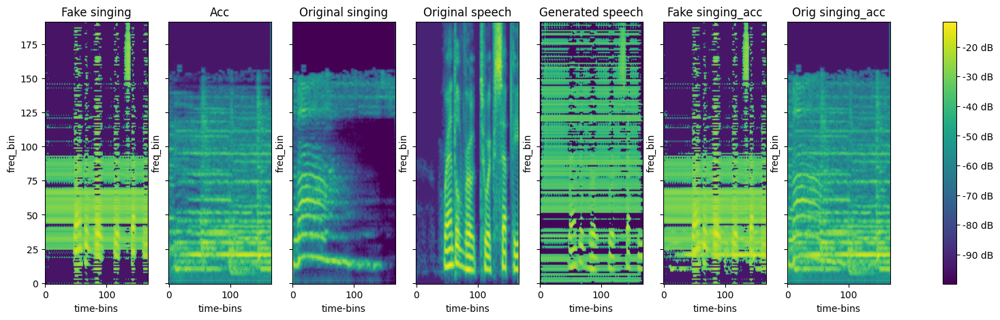

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 501
~ Running singing ~
tensor(1.8602e-05)
d_loss: 3.9738383293151855; built of 'd_loss_whole:1.986956000328064' & 'd_loss_vocal':1.9868824481964111
g_loss: 0.23427584767341614; built of 'g_loss_whole:-0.07321847975254059' & 'g_loss_vocal:-0.05118770897388458' & 'mae_loss_speech:0.12440481223165989' & 'mae_loss_identity:0.16838060691952705
~ Running speech ~
tensor(0.)
d_loss: 3.9765589237213135; built of 'd_loss_whole:1.9888317584991455' & 'd_loss_vocal':1.987727165222168
g_loss: 0.03660862520337105; built of 'g_loss_whole:-0.0746086910367012' & 'g_loss_vocal:-0.05183036997914314' & 'mae_loss_speech:0.09589986293576658' & 'mae_loss_identity:0.0
Running batch 502
~ Running singing ~
tensor(2.6042e-05)
d_loss: 3.9842419624328613; built of 'd_loss_whole:1.992128610610962' & 'd_loss_vocal':1.9921133518218994
g_loss: 0.23565928637981415; built of 'g_loss_whole:-0.0741855725646019' & 'g_loss_vocal:-0.05332312732934952' & 'mae_loss_speech:0.12187940301373601' & 'mae_loss_identi

100%|██████████| 1000/1000 [00:15<00:00, 64.05it/s, loss=0.000516, spectral_convergence=-7.31]


song original singing:


100%|██████████| 1000/1000 [00:16<00:00, 62.05it/s, loss=0.000349, spectral_convergence=-9.67]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 63.71it/s, loss=0.000347, spectral_convergence=-7.72]


original speech


100%|██████████| 1000/1000 [00:16<00:00, 61.64it/s, loss=0.000321, spectral_convergence=-11.6]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.54it/s, loss=0.000612, spectral_convergence=-9.74]


display spectrograms


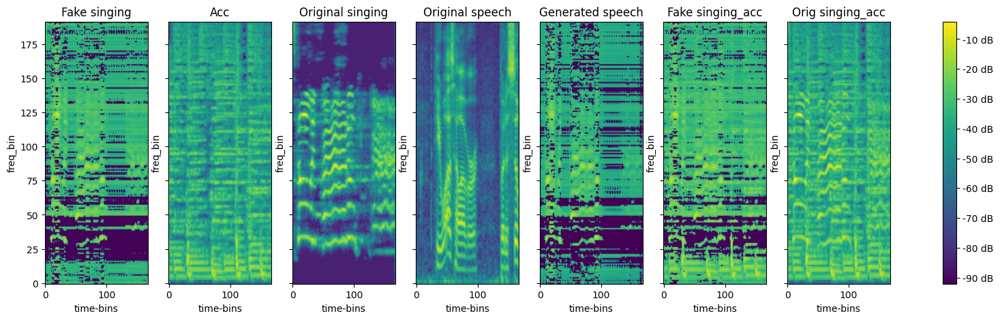

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.8601e-05)
d_loss: 3.9656906127929688; built of 'd_loss_whole:1.98332679271698' & 'd_loss_vocal':1.9823637008666992
g_loss: 0.02116495743393898; built of 'g_loss_whole:-0.0630289614200592' & 'g_loss_vocal:-0.04229388386011124' & 'mae_loss_speech:0.0697617419064045' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 64.41it/s, loss=0.000388, spectral_convergence=-8.93]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 64.36it/s, loss=0.000313, spectral_convergence=-10.3]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.71it/s, loss=0.000312, spectral_convergence=-8.7]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 62.54it/s, loss=0.000204, spectral_convergence=-13]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 65.17it/s, loss=0.000528, spectral_convergence=-9.81]


display spectrograms


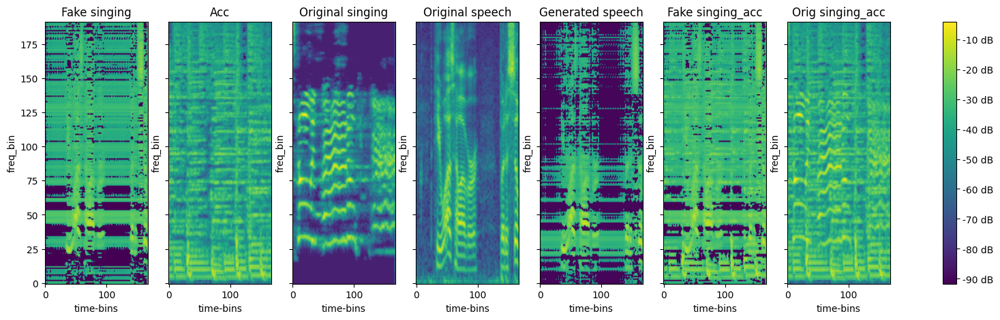

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 601
~ Running singing ~
tensor(1.1161e-05)
d_loss: 3.9875807762145996; built of 'd_loss_whole:1.994051456451416' & 'd_loss_vocal':1.9935293197631836
g_loss: 0.11732188612222672; built of 'g_loss_whole:-0.06295840442180634' & 'g_loss_vocal:-0.04319671168923378' & 'mae_loss_speech:0.07174930651672184' & 'mae_loss_identity:0.09506513015367091
~ Running speech ~
tensor(3.7203e-06)
d_loss: 3.983163833618164; built of 'd_loss_whole:1.992174744606018' & 'd_loss_vocal':1.9909892082214355
g_loss: 0.02815430983901024; built of 'g_loss_whole:-0.06133706122636795' & 'g_loss_vocal:-0.04061475023627281' & 'mae_loss_speech:0.07490276475436985' & 'mae_loss_identity:0.0
Running batch 602
~ Running singing ~
tensor(1.8601e-05)
d_loss: 3.9842171669006348; built of 'd_loss_whole:1.9918384552001953' & 'd_loss_vocal':1.992378830909729
g_loss: 0.15173253417015076; built of 'g_loss_whole:-0.058830626308918' & 'g_loss_vocal:-0.04280993714928627' & 'mae_loss_speech:0.08953367942012846' & 'mae_loss

100%|██████████| 1000/1000 [00:15<00:00, 66.58it/s, loss=0.000872, spectral_convergence=-4.2]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.53it/s, loss=0.000408, spectral_convergence=-12.4]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 66.96it/s, loss=0.000557, spectral_convergence=-9.11]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.25it/s, loss=0.000384, spectral_convergence=-13]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 63.10it/s, loss=0.0013, spectral_convergence=-11.5]


display spectrograms


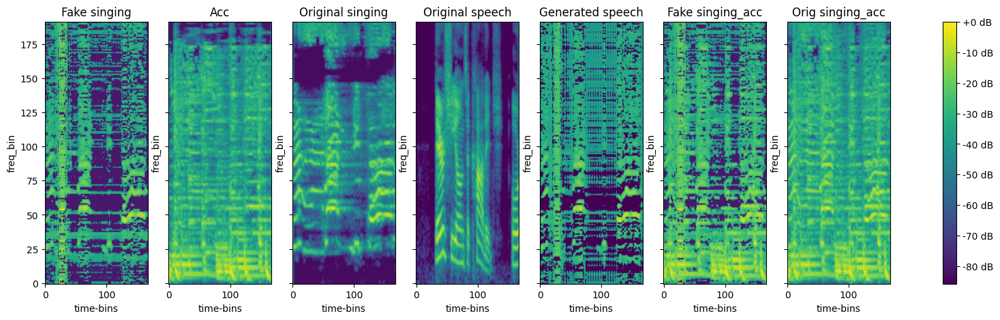

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(0.)
d_loss: 3.9547553062438965; built of 'd_loss_whole:1.9779653549194336' & 'd_loss_vocal':1.9767900705337524
g_loss: 0.012141205370426178; built of 'g_loss_whole:-0.062459513545036316' & 'g_loss_vocal:-0.042158182710409164' & 'mae_loss_speech:0.06054533878341317' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.62it/s, loss=0.000882, spectral_convergence=-3.3]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 63.89it/s, loss=0.000393, spectral_convergence=-13.5]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 67.80it/s, loss=0.000494, spectral_convergence=-10.2]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.78it/s, loss=0.000237, spectral_convergence=-14.7]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 66.32it/s, loss=0.00141, spectral_convergence=-11]


display spectrograms


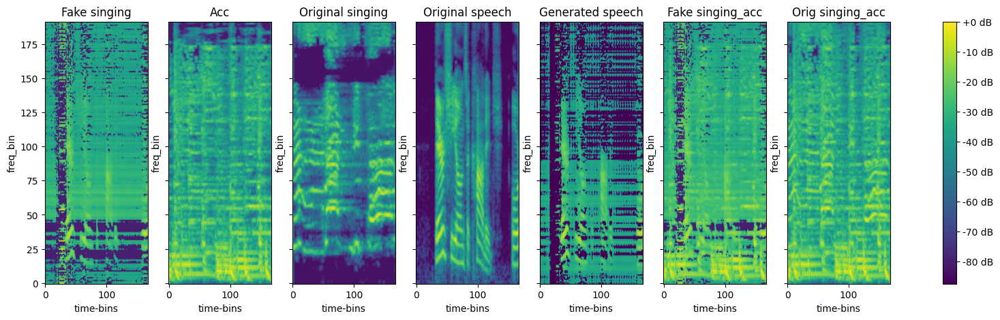

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 701
~ Running singing ~
tensor(0.0001)
d_loss: 3.9589481353759766; built of 'd_loss_whole:1.9792548418045044' & 'd_loss_vocal':1.9796932935714722
g_loss: 0.2846752405166626; built of 'g_loss_whole:-0.06556869298219681' & 'g_loss_vocal:-0.04845442250370979' & 'mae_loss_speech:0.15594603028148413' & 'mae_loss_identity:0.18374049104750156
~ Running speech ~
tensor(6.6965e-05)
d_loss: 3.9438467025756836; built of 'd_loss_whole:1.9721767902374268' & 'd_loss_vocal':1.9716699123382568
g_loss: -0.0005139224231243134; built of 'g_loss_whole:-0.0583382211625576' & 'g_loss_vocal:-0.040030352771282196' & 'mae_loss_speech:0.045350255095399916' & 'mae_loss_identity:0.0
Running batch 702
~ Running singing ~
tensor(6.3244e-05)
d_loss: 3.980520248413086; built of 'd_loss_whole:1.9901988506317139' & 'd_loss_vocal':1.9903212785720825
g_loss: 0.1614275425672531; built of 'g_loss_whole:-0.06430217623710632' & 'g_loss_vocal:-0.04416559264063835' & 'mae_loss_speech:0.09081908501684666' & 'mae_l

100%|██████████| 1000/1000 [00:15<00:00, 65.87it/s, loss=0.000493, spectral_convergence=-4.51]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 64.03it/s, loss=0.000219, spectral_convergence=-9.06]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 63.56it/s, loss=0.000195, spectral_convergence=-0.858]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.75it/s, loss=0.000235, spectral_convergence=-7.43]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 65.09it/s, loss=0.000559, spectral_convergence=-7.23]


display spectrograms


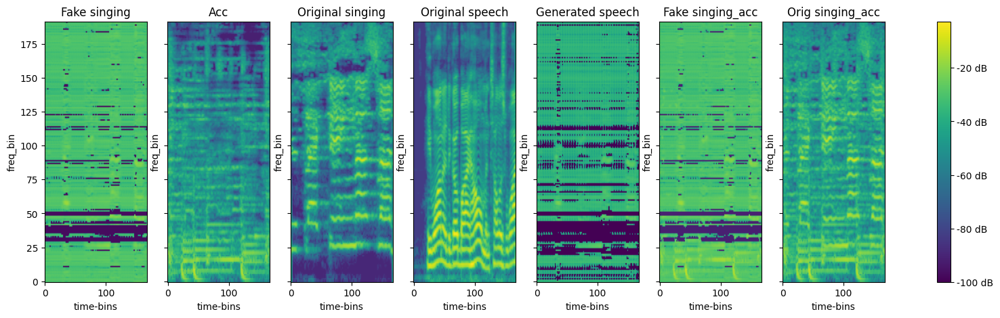

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(3.7203e-05)
d_loss: 3.9129185676574707; built of 'd_loss_whole:1.9560294151306152' & 'd_loss_vocal':1.9568891525268555
g_loss: 0.05723636969923973; built of 'g_loss_whole:-0.0673220083117485' & 'g_loss_vocal:-0.047143228352069855' & 'mae_loss_speech:0.11111180065199733' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.44it/s, loss=0.001, spectral_convergence=-9.76]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 62.73it/s, loss=0.000202, spectral_convergence=-9.71]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 63.68it/s, loss=0.000957, spectral_convergence=-10.3]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.92it/s, loss=0.000565, spectral_convergence=-15.2]


fake combine


100%|██████████| 1000/1000 [00:19<00:00, 50.91it/s, loss=0.00103, spectral_convergence=-9.95]


display spectrograms


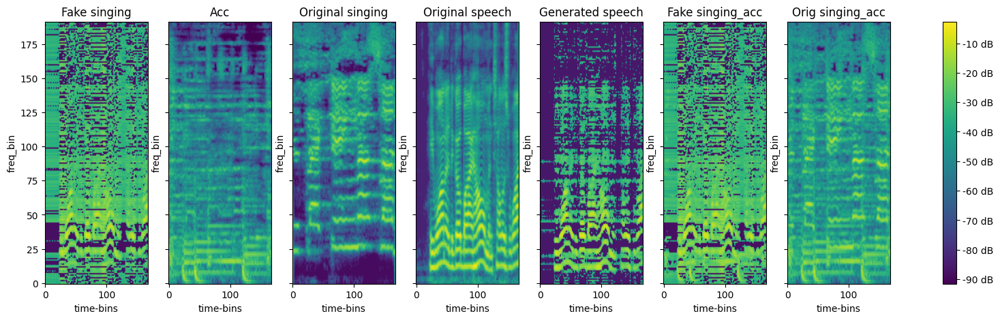

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 801
~ Running singing ~
tensor(5.5804e-05)
d_loss: 3.9582629203796387; built of 'd_loss_whole:1.978372573852539' & 'd_loss_vocal':1.9798903465270996
g_loss: 0.3190905451774597; built of 'g_loss_whole:-0.06448723375797272' & 'g_loss_vocal:-0.04939023405313492' & 'mae_loss_speech:0.1799732563085854' & 'mae_loss_identity:0.19495623419061303
~ Running speech ~
tensor(7.4406e-06)
d_loss: 3.947300434112549; built of 'd_loss_whole:1.9729552268981934' & 'd_loss_vocal':1.974345326423645
g_loss: 0.030487101525068283; built of 'g_loss_whole:-0.058494243770837784' & 'g_loss_vocal:-0.04381120949983597' & 'mae_loss_speech:0.08014773484319448' & 'mae_loss_identity:0.0
Running batch 802
~ Running singing ~
tensor(2.2322e-05)
d_loss: 3.955092668533325; built of 'd_loss_whole:1.9771709442138672' & 'd_loss_vocal':1.977921724319458
g_loss: 0.328044593334198; built of 'g_loss_whole:-0.07227008789777756' & 'g_loss_vocal:-0.05520994961261749' & 'mae_loss_speech:0.18673582235351205' & 'mae_loss_

100%|██████████| 1000/1000 [00:15<00:00, 65.53it/s, loss=0.000593, spectral_convergence=-8.66]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 63.91it/s, loss=0.000396, spectral_convergence=-12.1]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.13it/s, loss=0.000573, spectral_convergence=-9.55]


original speech


100%|██████████| 1000/1000 [00:14<00:00, 67.90it/s, loss=0.000422, spectral_convergence=-10.6]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 66.63it/s, loss=0.000685, spectral_convergence=-10.7]


display spectrograms


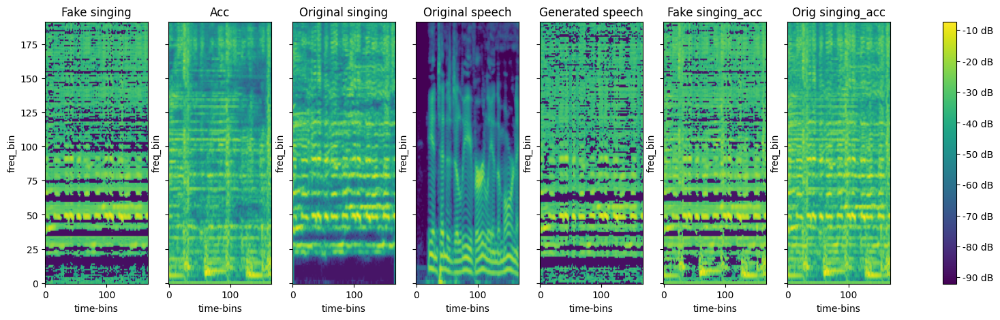

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(3.7202e-05)
d_loss: 3.9716711044311523; built of 'd_loss_whole:1.9872984886169434' & 'd_loss_vocal':1.984372615814209
g_loss: 0.00029778853058815; built of 'g_loss_whole:-0.059185050427913666' & 'g_loss_vocal:-0.034269675612449646' & 'mae_loss_speech:0.0404859718400985' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 63.78it/s, loss=0.000308, spectral_convergence=-4.76]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.63it/s, loss=0.000406, spectral_convergence=-12]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.19it/s, loss=0.000284, spectral_convergence=-3.92]


original speech


100%|██████████| 1000/1000 [00:14<00:00, 67.65it/s, loss=0.000151, spectral_convergence=-6.96]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 66.45it/s, loss=0.000488, spectral_convergence=-10.4]


display spectrograms


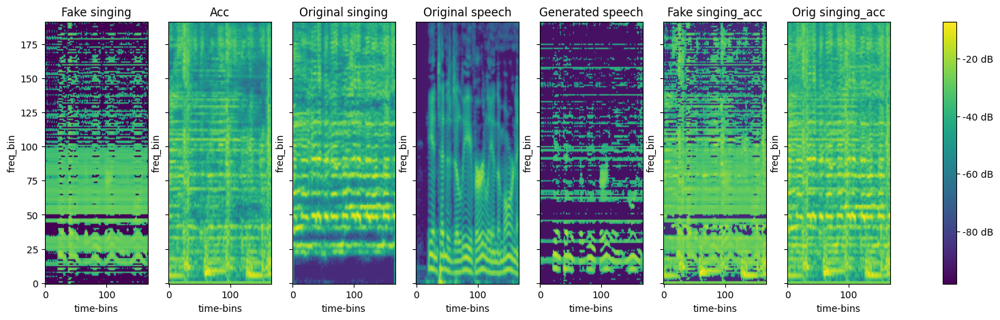

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 901
~ Running singing ~
tensor(3.7203e-05)
d_loss: 3.951535701751709; built of 'd_loss_whole:1.9766881465911865' & 'd_loss_vocal':1.9748475551605225
g_loss: 0.40220844745635986; built of 'g_loss_whole:-0.07787596434354782' & 'g_loss_vocal:-0.05047440901398659' & 'mae_loss_speech:0.21000902634114027' & 'mae_loss_identity:0.25046144146472216
~ Running speech ~
tensor(2.6042e-05)
d_loss: 3.9246373176574707; built of 'd_loss_whole:1.9643545150756836' & 'd_loss_vocal':1.960282802581787
g_loss: 0.00873558595776558; built of 'g_loss_whole:-0.06800301373004913' & 'g_loss_vocal:-0.03688368946313858' & 'mae_loss_speech:0.05241957842372358' & 'mae_loss_identity:0.0
Running batch 902
~ Running singing ~
tensor(9.3007e-05)
d_loss: 3.9676003456115723; built of 'd_loss_whole:1.9835904836654663' & 'd_loss_vocal':1.9840097427368164
g_loss: 0.23095175623893738; built of 'g_loss_whole:-0.056236252188682556' & 'g_loss_vocal:-0.0399131141602993' & 'mae_loss_speech:0.1245875027962029' & 'mae_l

100%|██████████| 1000/1000 [00:14<00:00, 66.81it/s, loss=0.000653, spectral_convergence=-1.86]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.71it/s, loss=0.000223, spectral_convergence=-11.3]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 66.48it/s, loss=0.000362, spectral_convergence=-8]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.20it/s, loss=0.000226, spectral_convergence=-10.8]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 63.49it/s, loss=0.00122, spectral_convergence=-12.6]


display spectrograms


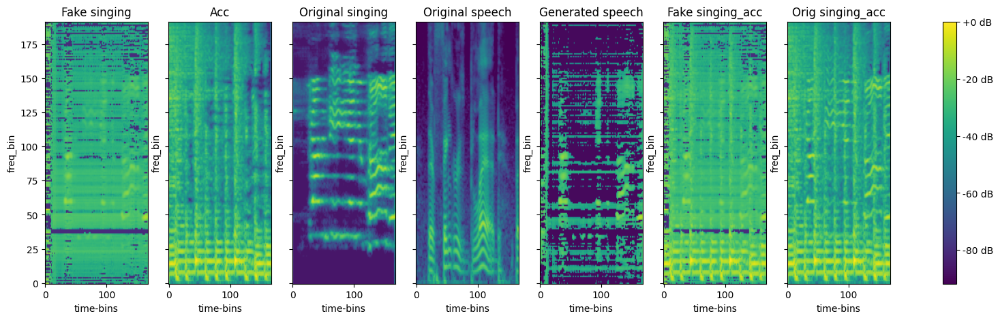

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.4881e-05)
d_loss: 3.9887919425964355; built of 'd_loss_whole:1.9946677684783936' & 'd_loss_vocal':1.9941240549087524
g_loss: -0.011571744456887245; built of 'g_loss_whole:-0.05464005842804909' & 'g_loss_vocal:-0.03693808615207672' & 'mae_loss_speech:0.03083034825976938' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:14<00:00, 67.64it/s, loss=0.000536, spectral_convergence=-2.12]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.32it/s, loss=0.000215, spectral_convergence=-11]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 66.11it/s, loss=0.000275, spectral_convergence=-4.56]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.61it/s, loss=8.56e-5, spectral_convergence=-8.7]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 63.79it/s, loss=0.0011, spectral_convergence=-13.1]


display spectrograms


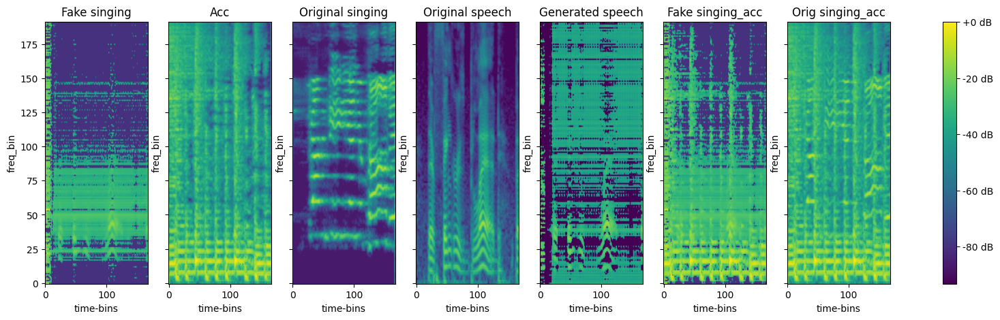

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1001
~ Running singing ~
tensor(9.3007e-05)
d_loss: 3.986253499984741; built of 'd_loss_whole:1.9930676221847534' & 'd_loss_vocal':1.9931858777999878
g_loss: 0.11563074588775635; built of 'g_loss_whole:-0.055749308317899704' & 'g_loss_vocal:-0.04146208614110947' & 'mae_loss_speech:0.06311888573691249' & 'mae_loss_identity:0.09954888373613358
~ Running speech ~
tensor(2.9762e-05)
d_loss: 3.989795684814453; built of 'd_loss_whole:1.9951409101486206' & 'd_loss_vocal':1.994654893875122
g_loss: 0.010883182287216187; built of 'g_loss_whole:-0.057658251374959946' & 'g_loss_vocal:-0.04285178333520889' & 'mae_loss_speech:0.059500790666788816' & 'mae_loss_identity:0.0
Running batch 1002
~ Running singing ~
tensor(4.0923e-05)
d_loss: 3.9772682189941406; built of 'd_loss_whole:1.9885109663009644' & 'd_loss_vocal':1.9887573719024658
g_loss: 0.18440566956996918; built of 'g_loss_whole:-0.0695420652627945' & 'g_loss_vocal:-0.048072975128889084' & 'mae_loss_speech:0.10331381345167756' & 

100%|██████████| 1000/1000 [00:15<00:00, 64.70it/s, loss=0.000887, spectral_convergence=-10.1]


song original singing:


100%|██████████| 1000/1000 [00:16<00:00, 59.89it/s, loss=0.000441, spectral_convergence=-14.6]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 64.85it/s, loss=0.000544, spectral_convergence=-10.5]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 66.10it/s, loss=0.000448, spectral_convergence=-14.2]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 67.39it/s, loss=0.00111, spectral_convergence=-12.6]


display spectrograms


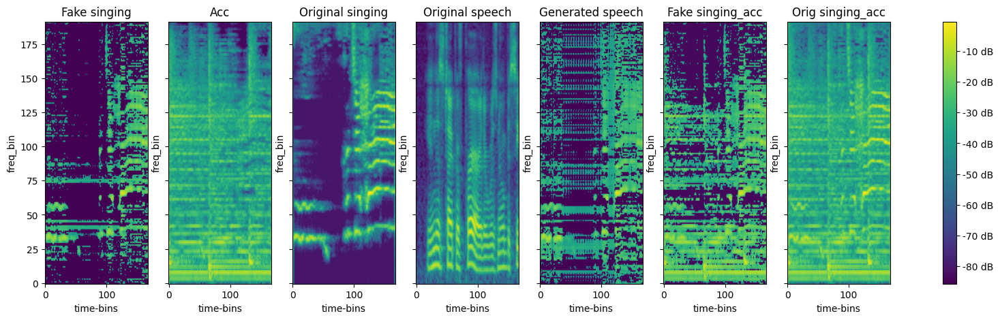

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(3.7203e-06)
d_loss: 3.960604190826416; built of 'd_loss_whole:1.980303168296814' & 'd_loss_vocal':1.9803011417388916
g_loss: 0.04342019185423851; built of 'g_loss_whole:-0.06096583232283592' & 'g_loss_vocal:-0.04642578214406967' & 'mae_loss_speech:0.0959425582550466' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.67it/s, loss=0.000781, spectral_convergence=-11]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 64.78it/s, loss=0.000419, spectral_convergence=-15.3]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 62.95it/s, loss=0.000602, spectral_convergence=-11.7]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.37it/s, loss=0.000401, spectral_convergence=-14.6]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.16it/s, loss=0.00108, spectral_convergence=-13]


display spectrograms


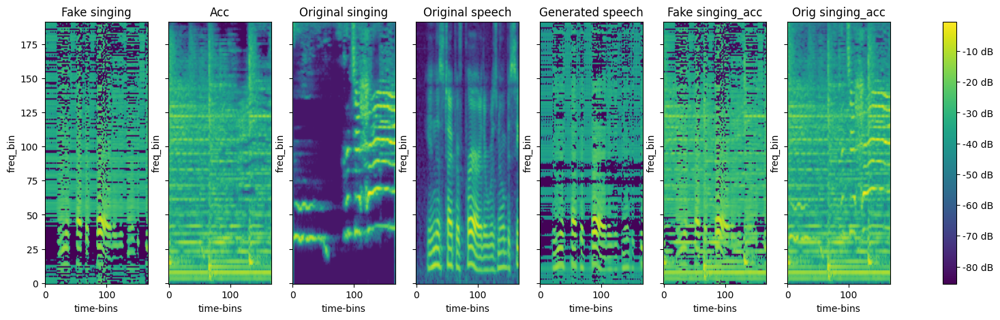

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1101
~ Running singing ~
tensor(4.8364e-05)
d_loss: 3.9647977352142334; built of 'd_loss_whole:1.9823145866394043' & 'd_loss_vocal':1.982483148574829
g_loss: 0.30948346853256226; built of 'g_loss_whole:-0.06953269243240356' & 'g_loss_vocal:-0.05228697508573532' & 'mae_loss_speech:0.16862702323123813' & 'mae_loss_identity:0.20009668078273535
~ Running speech ~
tensor(0.0001)
d_loss: 3.941760540008545; built of 'd_loss_whole:1.9712517261505127' & 'd_loss_vocal':1.9705089330673218
g_loss: 0.012450061738491058; built of 'g_loss_whole:-0.05943715572357178' & 'g_loss_vocal:-0.04040483012795448' & 'mae_loss_speech:0.058798608370125294' & 'mae_loss_identity:0.0
Running batch 1102
~ Running singing ~
tensor(5.2084e-05)
d_loss: 3.9664971828460693; built of 'd_loss_whole:1.983180046081543' & 'd_loss_vocal':1.9833171367645264
g_loss: 0.22709688544273376; built of 'g_loss_whole:-0.05944492295384407' & 'g_loss_vocal:-0.04442330822348595' & 'mae_loss_speech:0.12934308033436537' & 'mae_l

100%|██████████| 1000/1000 [00:15<00:00, 62.88it/s, loss=0.000573, spectral_convergence=-8.55]


song original singing:


100%|██████████| 1000/1000 [00:16<00:00, 61.55it/s, loss=0.000243, spectral_convergence=-14.9]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 64.95it/s, loss=0.000408, spectral_convergence=-8.7]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.07it/s, loss=0.000217, spectral_convergence=-15.9]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 66.64it/s, loss=0.000678, spectral_convergence=-10.2]


display spectrograms


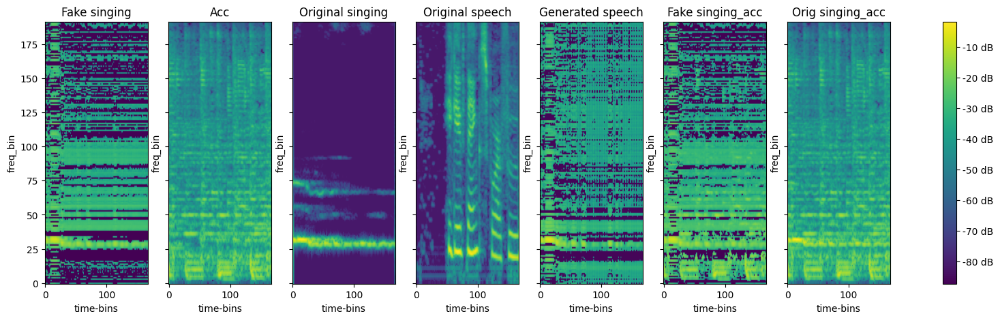

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(3.7203e-06)
d_loss: 3.9854488372802734; built of 'd_loss_whole:1.993436336517334' & 'd_loss_vocal':1.9920125007629395
g_loss: 0.016340553760528564; built of 'g_loss_whole:-0.06521852314472198' & 'g_loss_vocal:-0.044718340039253235' & 'mae_loss_speech:0.0675807474181056' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.17it/s, loss=0.000664, spectral_convergence=-12.2]


song original singing:


100%|██████████| 1000/1000 [00:16<00:00, 60.49it/s, loss=0.000238, spectral_convergence=-14.1]


generated speech:


100%|██████████| 1000/1000 [00:16<00:00, 60.10it/s, loss=0.000531, spectral_convergence=-14.1]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.87it/s, loss=0.000242, spectral_convergence=-17.4]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 65.65it/s, loss=0.000794, spectral_convergence=-12.2]


display spectrograms


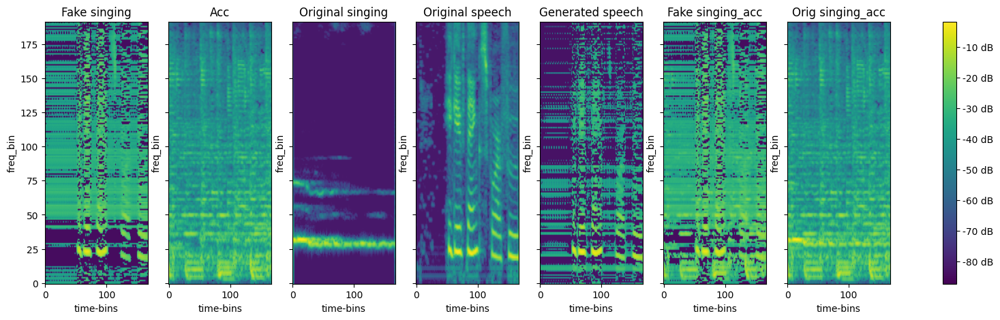

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1201
~ Running singing ~
tensor(2.6042e-05)
d_loss: 3.9689128398895264; built of 'd_loss_whole:1.984250545501709' & 'd_loss_vocal':1.9846622943878174
g_loss: 0.2225067913532257; built of 'g_loss_whole:-0.06663081049919128' & 'g_loss_vocal:-0.050210218876600266' & 'mae_loss_speech:0.12931209057569504' & 'mae_loss_identity:0.15006799949333072
~ Running speech ~
tensor(0.)
d_loss: 3.964830160140991; built of 'd_loss_whole:1.9825201034545898' & 'd_loss_vocal':1.9823100566864014
g_loss: 0.028437118977308273; built of 'g_loss_whole:-0.0642581358551979' & 'g_loss_vocal:-0.04756307974457741' & 'mae_loss_speech:0.08242601179517806' & 'mae_loss_identity:0.0
Running batch 1202
~ Running singing ~
tensor(5.2084e-05)
d_loss: 3.9834139347076416; built of 'd_loss_whole:1.9927277565002441' & 'd_loss_vocal':1.9906861782073975
g_loss: 0.20261654257774353; built of 'g_loss_whole:-0.07377303391695023' & 'g_loss_vocal:-0.044362835586071014' & 'mae_loss_speech:0.11150524951517582' & 'mae_loss_

100%|██████████| 1000/1000 [00:15<00:00, 63.92it/s, loss=0.000438, spectral_convergence=-1.25]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 64.43it/s, loss=0.000106, spectral_convergence=-7.88]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 64.47it/s, loss=0.000157, spectral_convergence=-5.04]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.10it/s, loss=0.000113, spectral_convergence=-6.76]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 67.43it/s, loss=0.00085, spectral_convergence=-13.9]


display spectrograms


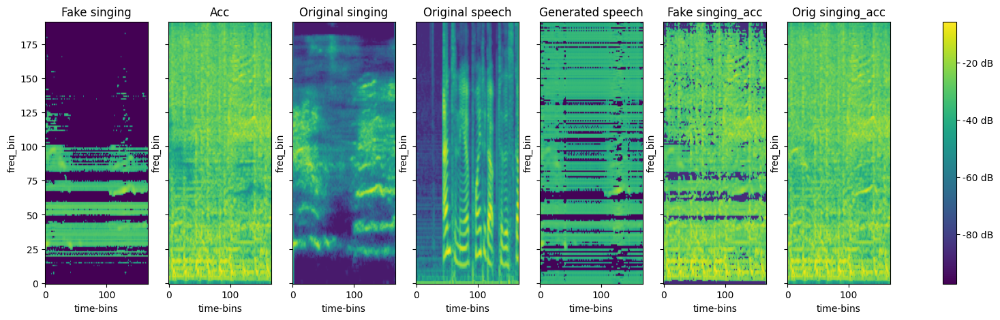

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.1161e-05)
d_loss: 3.997830390930176; built of 'd_loss_whole:1.9991693496704102' & 'd_loss_vocal':1.998660922050476
g_loss: 0.03349720686674118; built of 'g_loss_whole:-0.07542824000120163' & 'g_loss_vocal:-0.04454011842608452' & 'mae_loss_speech:0.08558015106245875' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 62.97it/s, loss=0.000533, spectral_convergence=-10.4]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 64.27it/s, loss=0.000119, spectral_convergence=-6.45]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.11it/s, loss=0.00037, spectral_convergence=-9.68]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.82it/s, loss=0.000272, spectral_convergence=-12]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 65.75it/s, loss=0.000925, spectral_convergence=-14.2]


display spectrograms


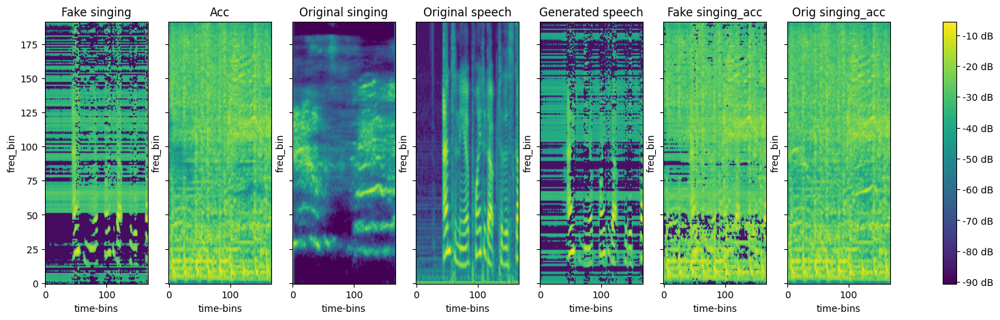

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1301
~ Running singing ~
tensor(5.9524e-05)
d_loss: 3.9865775108337402; built of 'd_loss_whole:1.9933539628982544' & 'd_loss_vocal':1.9932234287261963
g_loss: 0.144231379032135; built of 'g_loss_whole:-0.0572790764272213' & 'g_loss_vocal:-0.04188991338014603' & 'mae_loss_speech:0.0798027089331299' & 'mae_loss_identity:0.11204649927094579
~ Running speech ~
tensor(7.4406e-06)
d_loss: 3.9882757663726807; built of 'd_loss_whole:1.9942045211791992' & 'd_loss_vocal':1.9940712451934814
g_loss: 0.03480551391839981; built of 'g_loss_whole:-0.05805347114801407' & 'g_loss_vocal:-0.04270443692803383' & 'mae_loss_speech:0.08331529679708183' & 'mae_loss_identity:0.0
Running batch 1302
~ Running singing ~
tensor(3.3482e-05)
d_loss: 3.971514940261841; built of 'd_loss_whole:1.9856702089309692' & 'd_loss_vocal':1.9858447313308716
g_loss: 0.25988906621932983; built of 'g_loss_whole:-0.0674760639667511' & 'g_loss_vocal:-0.04985291138291359' & 'mae_loss_speech:0.13590125599876046' & 'mae_lo

100%|██████████| 1000/1000 [00:15<00:00, 64.93it/s, loss=0.000578, spectral_convergence=-6.48]


song original singing:


100%|██████████| 1000/1000 [00:14<00:00, 66.90it/s, loss=0.000213, spectral_convergence=-11.4]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.85it/s, loss=0.000414, spectral_convergence=-7.61]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 63.22it/s, loss=0.000222, spectral_convergence=-10.7]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 66.31it/s, loss=0.000716, spectral_convergence=-11]


display spectrograms


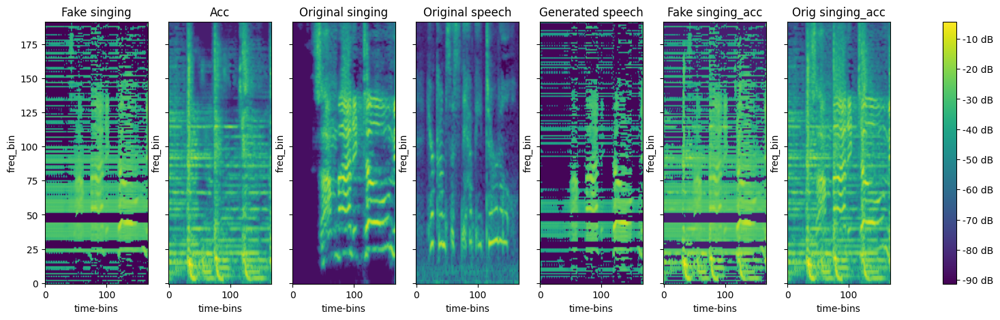

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.1161e-05)
d_loss: 3.982198715209961; built of 'd_loss_whole:1.9918702840805054' & 'd_loss_vocal':1.9903285503387451
g_loss: 0.016779545694589615; built of 'g_loss_whole:-0.07121431827545166' & 'g_loss_vocal:-0.042272262275218964' & 'mae_loss_speech:0.06617323961108923' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:14<00:00, 68.07it/s, loss=0.000316, spectral_convergence=-5.39]


song original singing:


100%|██████████| 1000/1000 [00:14<00:00, 67.38it/s, loss=0.000222, spectral_convergence=-11.4]


generated speech:


100%|██████████| 1000/1000 [00:14<00:00, 68.01it/s, loss=0.000183, spectral_convergence=-4.95]


original speech


100%|██████████| 1000/1000 [00:14<00:00, 66.79it/s, loss=8.96e-5, spectral_convergence=-7.25]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.24it/s, loss=0.000494, spectral_convergence=-11.9]


display spectrograms


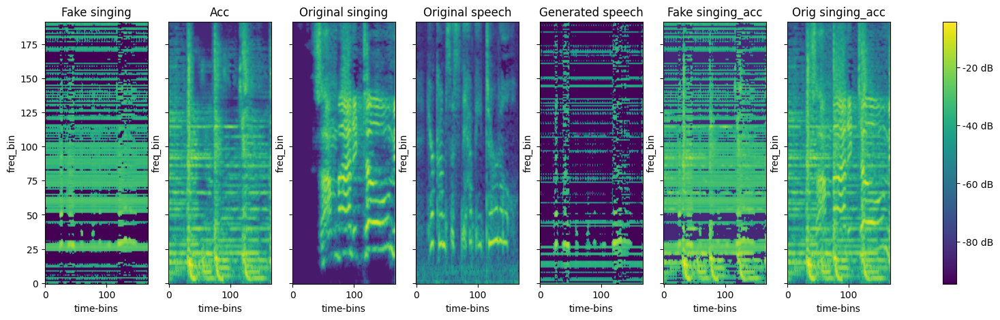

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1401
~ Running singing ~
tensor(4.0923e-05)
d_loss: 3.983567714691162; built of 'd_loss_whole:1.9918198585510254' & 'd_loss_vocal':1.9917477369308472
g_loss: 0.12420159578323364; built of 'g_loss_whole:-0.06041765585541725' & 'g_loss_vocal:-0.038997583091259' & 'mae_loss_speech:0.07643160060979426' & 'mae_loss_identity:0.0928093446418643
~ Running speech ~
tensor(1.4881e-05)
d_loss: 3.9891772270202637; built of 'd_loss_whole:1.9951515197753906' & 'd_loss_vocal':1.9940255880355835
g_loss: 0.013321004807949066; built of 'g_loss_whole:-0.06330230087041855' & 'g_loss_vocal:-0.0410594716668129' & 'mae_loss_speech:0.06071070674806833' & 'mae_loss_identity:0.0
Running batch 1402
~ Running singing ~
tensor(1.1161e-05)
d_loss: 3.990577220916748; built of 'd_loss_whole:1.9953715801239014' & 'd_loss_vocal':1.9952056407928467
g_loss: 0.12228347361087799; built of 'g_loss_whole:-0.0669146329164505' & 'g_loss_vocal:-0.04063338786363602' & 'mae_loss_speech:0.07140091620385647' & 'mae_lo

100%|██████████| 1000/1000 [00:15<00:00, 66.54it/s, loss=0.000347, spectral_convergence=-4.63]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.09it/s, loss=0.000164, spectral_convergence=-7.04]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.32it/s, loss=0.00028, spectral_convergence=-5]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 64.48it/s, loss=0.000161, spectral_convergence=-7.07]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.45it/s, loss=0.000505, spectral_convergence=-15.5]


display spectrograms


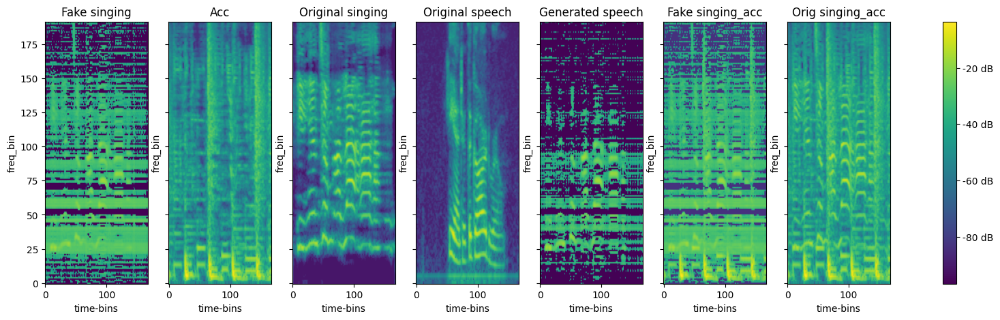

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(1.8601e-05)
d_loss: 3.995187759399414; built of 'd_loss_whole:1.9977115392684937' & 'd_loss_vocal':1.9974761009216309
g_loss: -0.004214011132717133; built of 'g_loss_whole:-0.055526625365018845' & 'g_loss_vocal:-0.036089103668928146' & 'mae_loss_speech:0.037427752977237105' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:14<00:00, 67.67it/s, loss=0.000408, spectral_convergence=-9.3]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 65.77it/s, loss=0.000158, spectral_convergence=-7.41]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.67it/s, loss=0.000288, spectral_convergence=-9.87]


original speech


100%|██████████| 1000/1000 [00:14<00:00, 66.95it/s, loss=0.000128, spectral_convergence=-10.9]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 65.74it/s, loss=0.000551, spectral_convergence=-13.5]


display spectrograms


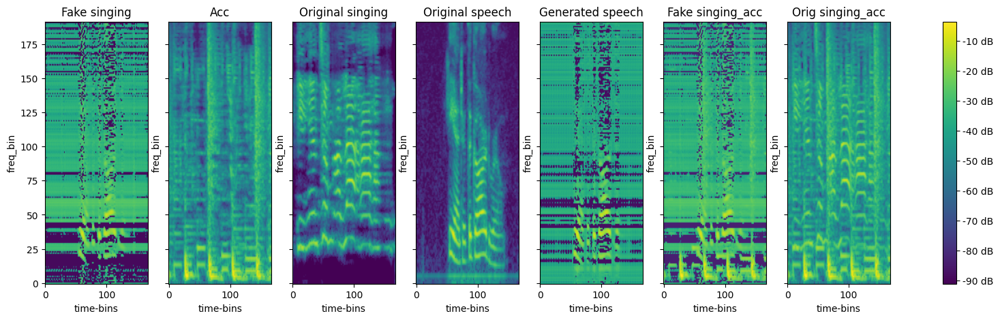

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1501
~ Running singing ~
tensor(5.9525e-05)
d_loss: 3.982555866241455; built of 'd_loss_whole:1.9914203882217407' & 'd_loss_vocal':1.991135597229004
g_loss: 0.14823167026042938; built of 'g_loss_whole:-0.05833589285612106' & 'g_loss_vocal:-0.041187893599271774' & 'mae_loss_speech:0.08448471198789775' & 'mae_loss_identity:0.11076843366026878
~ Running speech ~
tensor(3.7203e-06)
d_loss: 3.9815282821655273; built of 'd_loss_whole:1.9911432266235352' & 'd_loss_vocal':1.9903850555419922
g_loss: 0.011928047984838486; built of 'g_loss_whole:-0.05867643654346466' & 'g_loss_vocal:-0.04073191061615944' & 'mae_loss_speech:0.05852760514244437' & 'mae_loss_identity:0.0
Running batch 1502
~ Running singing ~
tensor(8.1846e-05)
d_loss: 3.977066993713379; built of 'd_loss_whole:1.9887988567352295' & 'd_loss_vocal':1.9882681369781494
g_loss: 0.1701957881450653; built of 'g_loss_whole:-0.06746633350849152' & 'g_loss_vocal:-0.043603915721178055' & 'mae_loss_speech:0.09565175278112292' & 'm

100%|██████████| 1000/1000 [00:15<00:00, 66.11it/s, loss=0.000639, spectral_convergence=-10.6]


song original singing:


100%|██████████| 1000/1000 [00:14<00:00, 66.79it/s, loss=0.000351, spectral_convergence=-14]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 62.84it/s, loss=0.000592, spectral_convergence=-10.9]


original speech


100%|██████████| 1000/1000 [00:16<00:00, 60.92it/s, loss=0.000354, spectral_convergence=-14.1]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.07it/s, loss=0.000965, spectral_convergence=-14.9]


display spectrograms


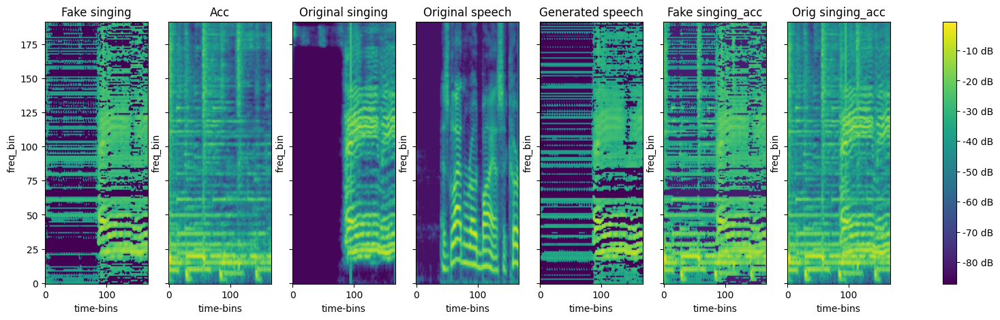

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(0.)
d_loss: 3.978487968444824; built of 'd_loss_whole:1.989640712738037' & 'd_loss_vocal':1.9888471364974976
g_loss: 0.04396411031484604; built of 'g_loss_whole:-0.073082335293293' & 'g_loss_vocal:-0.046638842672109604' & 'mae_loss_speech:0.0979111879132688' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.28it/s, loss=0.000832, spectral_convergence=-10.7]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.27it/s, loss=0.00036, spectral_convergence=-13.6]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 66.09it/s, loss=0.000675, spectral_convergence=-12]


original speech


100%|██████████| 1000/1000 [00:16<00:00, 60.63it/s, loss=0.000334, spectral_convergence=-16.3]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 65.75it/s, loss=0.00105, spectral_convergence=-15.5]


display spectrograms


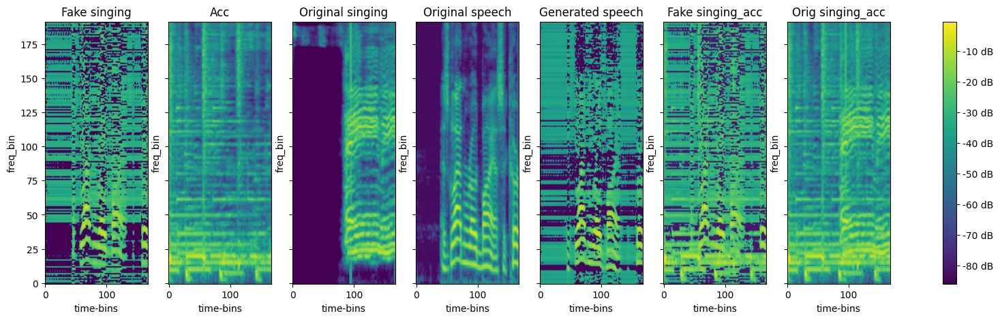

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1601
~ Running singing ~
tensor(3.7203e-05)
d_loss: 3.994697093963623; built of 'd_loss_whole:1.9973877668380737' & 'd_loss_vocal':1.9973094463348389
g_loss: 0.07314920425415039; built of 'g_loss_whole:-0.056147657334804535' & 'g_loss_vocal:-0.03697165846824646' & 'mae_loss_speech:0.0469597551273182' & 'mae_loss_identity:0.06877586711198092
~ Running speech ~
tensor(0.)
d_loss: 4.0029520988464355; built of 'd_loss_whole:2.001467704772949' & 'd_loss_vocal':2.0014843940734863
g_loss: 0.006672356277704239; built of 'g_loss_whole:-0.05989072471857071' & 'g_loss_vocal:-0.04117695614695549' & 'mae_loss_speech:0.053838384337723255' & 'mae_loss_identity:0.0
Running batch 1602
~ Running singing ~
tensor(7.4406e-06)
d_loss: 3.969742774963379; built of 'd_loss_whole:1.9848237037658691' & 'd_loss_vocal':1.9849189519882202
g_loss: 0.26006436347961426; built of 'g_loss_whole:-0.07426095008850098' & 'g_loss_vocal:-0.04830639809370041' & 'mae_loss_speech:0.13554284814745188' & 'mae_loss_

100%|██████████| 1000/1000 [00:15<00:00, 62.53it/s, loss=0.00062, spectral_convergence=-11.1]


song original singing:


100%|██████████| 1000/1000 [00:16<00:00, 62.49it/s, loss=0.000336, spectral_convergence=-14]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 64.49it/s, loss=0.000469, spectral_convergence=-10.6]


original speech


100%|██████████| 1000/1000 [00:16<00:00, 62.06it/s, loss=0.000329, spectral_convergence=-15.5]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 64.33it/s, loss=0.000885, spectral_convergence=-13.3]


display spectrograms


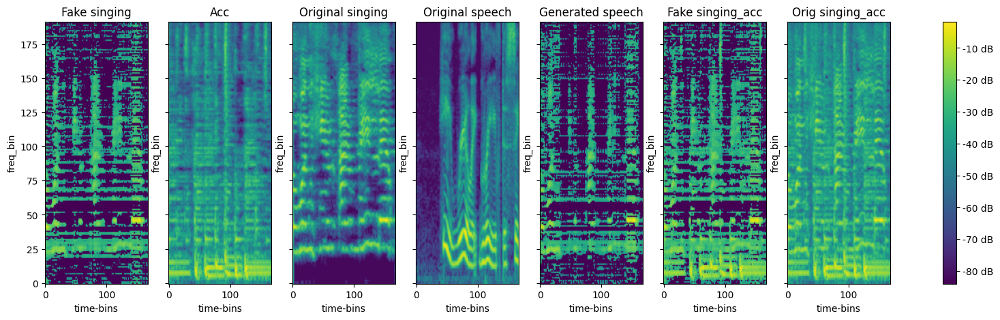

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(2.6042e-05)
d_loss: 3.9814372062683105; built of 'd_loss_whole:1.9914631843566895' & 'd_loss_vocal':1.989974021911621
g_loss: 0.02361159399151802; built of 'g_loss_whole:-0.07056290656328201' & 'g_loss_vocal:-0.04312039166688919' & 'mae_loss_speech:0.07378828013315797' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:18<00:00, 54.11it/s, loss=0.000873, spectral_convergence=-11.1]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 63.14it/s, loss=0.000319, spectral_convergence=-15]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.35it/s, loss=0.000648, spectral_convergence=-11.5]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 66.45it/s, loss=0.000351, spectral_convergence=-17.3]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 67.68it/s, loss=0.00111, spectral_convergence=-13.3]


display spectrograms


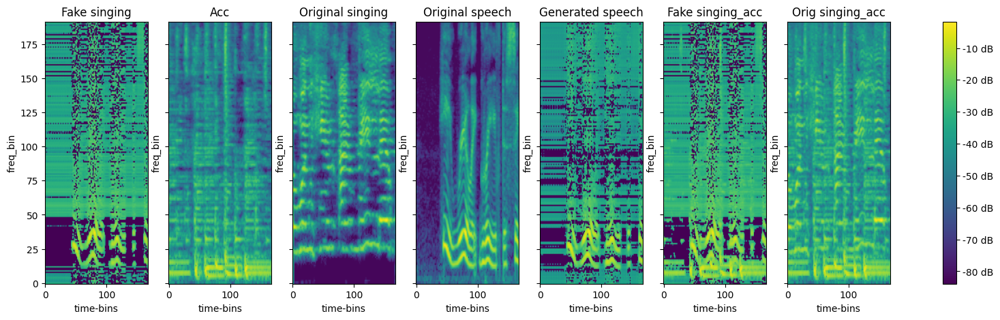

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


Running batch 1701
~ Running singing ~
tensor(5.5804e-05)
d_loss: 3.967289447784424; built of 'd_loss_whole:1.983615756034851' & 'd_loss_vocal':1.9836738109588623
g_loss: 0.3512795567512512; built of 'g_loss_whole:-0.08451718091964722' & 'g_loss_vocal:-0.05905281752347946' & 'mae_loss_speech:0.19128697458654642' & 'mae_loss_identity:0.22749709896743298
~ Running speech ~
tensor(7.4406e-06)
d_loss: 3.935293197631836; built of 'd_loss_whole:1.9684436321258545' & 'd_loss_vocal':1.966849446296692
g_loss: 0.009272221475839615; built of 'g_loss_whole:-0.06970113515853882' & 'g_loss_vocal:-0.04258766770362854' & 'mae_loss_speech:0.05883000558242202' & 'mae_loss_identity:0.0
Running batch 1702
~ Running singing ~
tensor(4.0923e-05)
d_loss: 3.9763941764831543; built of 'd_loss_whole:1.9884116649627686' & 'd_loss_vocal':1.9879826307296753
g_loss: 0.23002682626247406; built of 'g_loss_whole:-0.06168591231107712' & 'g_loss_vocal:-0.044389642775058746' & 'mae_loss_speech:0.12771193869411945' & 'mae

100%|██████████| 1000/1000 [00:16<00:00, 59.88it/s, loss=0.00068, spectral_convergence=-9.72]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 66.57it/s, loss=0.000354, spectral_convergence=-13.8]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 65.69it/s, loss=0.000548, spectral_convergence=-10.5]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.07it/s, loss=0.000404, spectral_convergence=-11.2]


fake combine


100%|██████████| 1000/1000 [00:14<00:00, 68.93it/s, loss=0.000964, spectral_convergence=-14.5]


display spectrograms


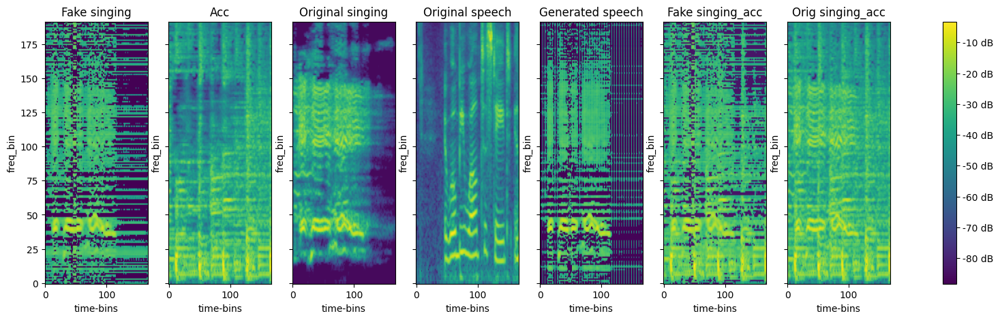

COMET WARNING: Please use the log_figure() method for logging a matplotlib.Figure. The log_image() method is not suitable for this purpose and will not record the image data.


~ Running speech ~
tensor(7.4406e-06)
d_loss: 3.992164134979248; built of 'd_loss_whole:1.9969089031219482' & 'd_loss_vocal':1.9952553510665894
g_loss: 0.07899226248264313; built of 'g_loss_whole:-0.07501155138015747' & 'g_loss_vocal:-0.0480523556470871' & 'mae_loss_speech:0.13454577419906855' & 'mae_loss_identity:0.0
generated singing:


100%|██████████| 1000/1000 [00:16<00:00, 61.17it/s, loss=0.000964, spectral_convergence=-9.71]


song original singing:


100%|██████████| 1000/1000 [00:15<00:00, 63.23it/s, loss=0.000366, spectral_convergence=-11.6]


generated speech:


100%|██████████| 1000/1000 [00:15<00:00, 63.21it/s, loss=0.000554, spectral_convergence=-11.1]


original speech


100%|██████████| 1000/1000 [00:15<00:00, 65.71it/s, loss=0.000304, spectral_convergence=-14.7]


fake combine


100%|██████████| 1000/1000 [00:15<00:00, 66.02it/s, loss=0.00111, spectral_convergence=-14]


display spectrograms
Buffered data was truncated after reaching the output size limit.

In [ ]:
opt_gen, opt_disc = optimizers
for epoch in range(epochs):
    # Iterate over your dataset in batches
    batch_number = 0
    try:
      for batch in dl:
        print(f"Running batch {batch_number}")
        mel_accs, mel_vocs, mel_speeches = batch
        mel_accs = mel_accs.to(device)
        mel_vocs = mel_vocs.to(device)
        mel_speeches = mel_speeches.to(device)

        # normalize all apectrogram to 1
        mel_accs = mel_accs / torch.max(mel_accs)
        mel_vocs = mel_vocs / torch.max(mel_vocs)
        mel_speeches = mel_speeches / torch.max(mel_speeches)

        mel_origs = combine_mel_spectrograms(mel_vocs, mel_accs)
        for voices in [{'type': 'singing', 'mels': mel_vocs}, {'type': 'speech', 'mels': mel_speeches}]:
          print(f"~ Running {voices['type']} ~")
          mel_voices = voices['mels']
          # Run Generators
          fake_vocs = gen_speech2sing(mel_voices, mel_accs)
          fake_vocs = fake_vocs / torch.max(fake_vocs)
          voc_to_speech = gen_sing2speech(fake_vocs)
          fake_combine = combine_mel_spectrograms(fake_vocs, mel_accs)

          # Run Discriminators
          whole_real_output = discrim_whole(mel_origs)
          whole_fake_output = discrim_whole(fake_combine.detach())
          vocal_real_output = discrim_vocal(mel_vocs)
          vocal_fake_output = discrim_vocal(fake_vocs.detach())

          # Train discriminators
          opt_gen.zero_grad()
          opt_disc.zero_grad()
          d_loss_whole = d_loss_r(whole_real_output) + d_loss_f(whole_fake_output)
          d_loss_vocal = d_loss_r(vocal_real_output) + d_loss_f(vocal_fake_output)
          d_loss = d_loss_whole + d_loss_vocal
          d_loss.backward()
          print(list(discrim_whole.parameters())[4].grad.max())
          opt_disc.step()

          #Train generators
          opt_gen.zero_grad()
          opt_disc.zero_grad()

          # Get average powers:
          # fake_vocs_power = torch.mean(fake_vocs.pow(2), dim=(1, 2, 3))
          # real_vocs_power = torch.mean(mel_vocs.pow(2), dim=(1, 2, 3))

          whole_fake_output = discrim_whole(fake_combine)
          vocal_fake_output = discrim_vocal(fake_vocs)
          g_loss_whole = g_loss_f(whole_fake_output)
          g_loss_vocal = g_loss_f(vocal_fake_output)
          mae_loss_speech = mae(voc_to_speech, mel_voices)
          mae_loss_identity = mae(fake_vocs, mel_vocs) if voices['type'] == 'singing' else torch.tensor(0.0)
          # power_gap = torch.mean(torch.abs(fake_vocs_power - real_vocs_power))
          g_loss = 0.1 * g_loss_whole + g_loss_vocal + 100.0 * mae_loss_speech + 100.0 * mae_loss_identity #+ 0.001 * power_gap
          g_loss.backward()
          opt_gen.step()
          print(f"d_loss: {d_loss.item()}; built of 'd_loss_whole:{d_loss_whole.item()}' & 'd_loss_vocal':{d_loss_vocal.item()}")
          print(f"g_loss: {g_loss.item()}; built of 'g_loss_whole:{g_loss_whole.item()}' & 'g_loss_vocal:{g_loss_vocal.item()}' & 'mae_loss_speech:{mae_loss_speech.item() * 100.0}' & 'mae_loss_identity:{mae_loss_identity.item() * 100.0}")

          if batch_number % 100 == 0:
            try:
              print("generated singing:")
              reconstructed_audio = GRAD(fake_vocs[0].detach().cpu(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
              print("song original singing:")
              reconstructed_audio_voc = GRAD(mel_vocs[0].detach().cpu(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
              print("generated speech:")
              reconstructed_audio_speech = GRAD(voc_to_speech[0].detach().cpu(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
              print("original speech")
              reconstructed_audio_orig = GRAD(mel_voices[0].detach().cpu(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
              print("fake combine")
              reconstructed_audio_acc = GRAD(fake_combine[0].detach().cpu(), mel_transform)
              ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
              print("display spectrograms")
              fig, axs = plt.subplots(1, 7, figsize=(20, 5), sharey=True)  # 1 row, 4 columns
              # Calculate overall min and max values for consistent color scale
              all_spectrograms = [fake_vocs[0].detach().cpu().numpy().squeeze(),
                                  mel_accs[0].detach().cpu().numpy().squeeze(),
                                  mel_vocs[0].detach().cpu().numpy().squeeze(),
                                  mel_speeches[0].detach().cpu().numpy().squeeze(),
                                  voc_to_speech[0].detach().cpu().numpy().squeeze(),
                                  fake_combine[0].detach().cpu().numpy().squeeze(),
                                  mel_origs[0].detach().cpu().numpy().squeeze()
                                  ]
              vmin = np.min([np.min(librosa.power_to_db(spec)) for spec in all_spectrograms])
              vmax = np.max([np.max(librosa.power_to_db(spec)) for spec in all_spectrograms])

              # Plot spectrograms
              im1 = display_spectrogram(all_spectrograms[0], title=f'Fake singing', ax=axs[0], vmin=vmin, vmax=vmax)
              im2 = display_spectrogram(all_spectrograms[1], title='Acc', ax=axs[1], vmin=vmin, vmax=vmax)
              im3 = display_spectrogram(all_spectrograms[2], title=f'Original singing', ax=axs[2], vmin=vmin, vmax=vmax)
              im4 = display_spectrogram(all_spectrograms[3], title='Original speech', ax=axs[3], vmin=vmin, vmax=vmax)
              im5 = display_spectrogram(all_spectrograms[4], title='Generated speech', ax=axs[4], vmin=vmin, vmax=vmax)
              im6 = display_spectrogram(all_spectrograms[5], title='Fake singing_acc', ax=axs[5], vmin=vmin, vmax=vmax)
              im7 = display_spectrogram(all_spectrograms[6], title='Orig singing_acc', ax=axs[6], vmin=vmin, vmax=vmax)
              # Add a single colorbar
              fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

              plt.show()

              # log to comet
              experiment.log_metric(f"batch_type", voices['type'])

              experiment.log_metric(f"d_loss_whole", d_loss_whole.item())
              experiment.log_metric(f"d_loss_vocal", d_loss_vocal.item())
              experiment.log_metric(f"d_loss", d_loss.item())
              experiment.log_metric(f"g_loss_whole", g_loss_whole.item())
              experiment.log_metric(f"g_loss_vocal", g_loss_vocal.item())
              experiment.log_metric(f"mae_loss_speech", mae_loss_speech.item())
              experiment.log_metric(f"mae_loss_identity", mae_loss_identity.item())
              experiment.log_metric(f"g_loss", g_loss.item())

              experiment.log_audio(audio_data = reconstructed_audio, sample_rate=sr, file_name=f"fake_vocs")
              experiment.log_audio(file_name=f"input audio (speech/singing)", audio_data =reconstructed_audio_orig, sample_rate=sr)
              experiment.log_audio(file_name=f"back_to_speech", audio_data =reconstructed_audio_speech, sample_rate=sr)
              experiment.log_audio(file_name=f"combine_song_output", audio_data =reconstructed_audio_acc, sample_rate=sr)

              experiment.log_image(image_data=fig, name='spectrograms')
              if voices['type'] == 'speech':
                save_models(gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal)

            except Exception as e:
                print(f"Error Saving: {e}")
                import traceback
                print(traceback.format_exc())
        batch_number += 1

    except Exception as e:
        print(f"Error during training: {e}")
        import traceback
        print(traceback.format_exc())

    # print(f"Models saved for epoch {epoch + 1} in {save_path}")

In [ ]:
experiment.end()

In [ ]:
discrim_whole.conv1[0].weight.shape

In [ ]:
list(discrim_whole.parameters())[1].shape


In [ ]:
list(discrim_whole.parameters())[4].grad.max()


In [ ]:
gen_speech2sing.conv1_acc[0].weight

In [ ]:
print("generated singing:")
reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
print("song original singing:")
reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
print("generated speech:")
reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
print("original speech")
reconstructed_audio_orig = GRAD(mel_speeches[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
print("fake combine")
reconstructed_audio_acc = GRAD(fake_combine[0].detach(), mel_transform)
ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
print("display spectrograms")
fig, axs = plt.subplots(1, 6, figsize=(20, 5), sharey=True)  # 1 row, 4 columns
# Calculate overall min and max values for consistent color scale
all_spectrograms = [fake_vocs[0].detach().numpy().squeeze(),
                    mel_accs[0].detach().numpy().squeeze(),
                    mel_vocs[0].detach().numpy().squeeze(),
                    mel_speeches[0].detach().numpy().squeeze()]
vmin = np.min([np.min(librosa.power_to_db(spec)) for spec in all_spectrograms])
vmax = np.max([np.max(librosa.power_to_db(spec)) for spec in all_spectrograms])

# Plot spectrograms
im1 = display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title=f'Fake singing', ax=axs[0], vmin=vmin, vmax=vmax)
im2 = display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc', ax=axs[1], vmin=vmin, vmax=vmax)
im3 = display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title=f'Original singing', ax=axs[2], vmin=vmin, vmax=vmax)
im4 = display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech', ax=axs[3], vmin=vmin, vmax=vmax)
im5 = display_spectrogram(voc_to_speech[0].detach().numpy().squeeze(), title='Generated speech', ax=axs[4], vmin=vmin, vmax=vmax)
im4 = display_spectrogram(fake_combine[0].detach().numpy().squeeze(), title='Fake singing_acc', ax=axs[5], vmin=vmin, vmax=vmax)

# Add a single colorbar
fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

plt.show()

In [ ]:
import matplotlib.pyplot as plt
print("generated singing:")
# reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
# display fake_vocs[0] spectrogram image

# plt.imshow(fake_vocs[0].detach().numpy().squeeze(), aspect='auto', origin='lower', cmap='viridis')
# plt.colorbar(format='%+2.0f dB')
# plt.title('Mel Spectrogram')
# plt.xlabel('Time')
# plt.ylabel('Frequency')
# Assuming fake_vocs, mel_accs, mel_vocs, mel_speeches are defined
fig, axs = plt.subplots(1, 4, figsize=(20, 5), sharey=True)  # 1 row, 4 columns

# Plot spectrograms
im1 = display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title='Fake singing spectrogram', ax=axs[0])
im2 = display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc', ax=axs[1])
im3 = display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title='Original singing spectrogram', ax=axs[2])
im4 = display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech spectrogram', ax=axs[3])

# Add a single colorbar
fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

plt.show()


# print("song original singing:")
# reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
# print("generated speech:")
# reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
# print("original speech")
# reconstructed_audio_orig = GRAD(mel_speeches[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
# print("original accompinemant")
# reconstructed_audio_acc = GRAD(mel_accs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
# save_models(gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal)